<h1> BT4222: Group 14 Final Project </h1>

    
<b>Done by:</b>
- Jerome Seah Jia Jun
- Lim Qin Da
- Ong Sijie Grace
- Tham Shun Cong Aaron
- You Jing

## Problem Statement: 
Fast fashion is a serious environmental issue. The fashion industry contributes to nearly 10% of global carbon emissions (Earth.Org). More seriously, US$500 billion is lost annually due to under-wearing and failure to recycle clothing (Earth.Org). In particular, online shopping contributes to significant wastage. Many returned items are more often disposed of straight to landfills than resold, creating massive heaps of fast fashion wastage (The Guardian). 

To mitigate this issue, online clothing rental is a way to encourage sustainable shopping. Clothing rental is becoming increasingly prevalent. The global online clothing rental market is expected to grow at a CAGR of 8.89% over the next few years (Mordor Intelligence). Driven by increasing trends of eco-friendly fashion and a desire for greater fashion choices at affordable price points, APAC is expected to contribute to 44% of total growth (PRNewswire). 

Despite increasing preference towards online clothing rental, consumers continue to face common problems such as apparel misfits. 72% of customers indicated they had returned clothes online as they did not fit well (The Business Journal). This resulted in increased costs incurred due to size-related issue returns and lower customer satisfaction. For instance, the replacement of rented apparel with incorrect fits cost $12.95 in shipping and is only available within the first 48 hours after placing an order (Rent The Runway). This also results in lower revenue for online apparel rental shops. 

## Our Project's Initiative:
To alleviate environmental issues of fast fashion wastage while enabling 
- (1) Better revenue flow for online shops and 
- (2) Better shopping experience for customers at online apparel rental stores, <br>

Our group seeks to (A) analyse clothing rental data to uncover insights on clothes that do not fit and (B) use modelling to help consumer predict clothing fit, enabling convenience while they shop and allow online retailers to sustain revenue while reducing the detrimental impact on the environment. 


## Project Summary 

After cleaning the data, the variables were analysed to conduct a preliminary investigation of their influence on fit. As clothing fit is subjective, beyond exploratory data analysis, sentiment analysis and topic modelling was conducted, utilising NLP techniques to value-add to the models using unstructured data from customer reviews. The team trained 5 different classification models, namely Logistic Regression, Random Forest, Gradient Boost, AdaBoost, and XGBoost. The F1-score was used as the main evaluation metric, coupled with elapsed time to account for the real-time usability of a fit recommender system. The final chosen model uses XGBoost (TF-IDF) with feature selection and has the best F1-score score of 0.602, with a reasonable runtime of 28.0 seconds. To further value-add in the business process and expand the project’s use case beyond online clothing rental onto other e-commerce apparel websites, the team also explored further extensions of using RCA to enhance the model. 

In [1]:
#Utility Packages
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
import pycld2 as cld2
import re
import regex
import seaborn as sns
import string
import time
import unicodedata
import matplotlib.pyplot as plt

from plotly.subplots import make_subplots
from collections import defaultdict, Counter
from scipy import stats
from math import pi
from tabulate import tabulate

from warnings import simplefilter
simplefilter(action="ignore", category=pd.errors.PerformanceWarning)

In [2]:
#SKlearn & other ML Packages
import shap
from sklearn.decomposition import PCA
from sklearn.utils.class_weight import compute_sample_weight
from sklearn.preprocessing import LabelEncoder, MinMaxScaler, OneHotEncoder, StandardScaler, OrdinalEncoder
from sklearn.ensemble import AdaBoostClassifier, ExtraTreesClassifier, GradientBoostingClassifier, RandomForestClassifier
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.feature_selection import SelectFromModel
from sklearn.metrics import r2_score, classification_report, confusion_matrix, accuracy_score, roc_auc_score, roc_curve, precision_recall_curve, average_precision_score
from sklearn.metrics import homogeneity_score, silhouette_score, log_loss, ConfusionMatrixDisplay, precision_score, recall_score, f1_score
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.experimental import enable_halving_search_cv
from sklearn.model_selection import HalvingGridSearchCV, HalvingRandomSearchCV, train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.inspection import permutation_importance
from xgboost.sklearn import XGBClassifier
from imblearn.over_sampling import SMOTE, ADASYN, SMOTENC

C:\Users\user\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.8_qbz5n2kfra8p0\LocalCache\local-packages\Python38\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
#NLP/NLTC/Topic packages
import contractions
from bertopic import BERTopic
from textblob import TextBlob, Blobber
from nltk.corpus import stopwords, wordnet
from nltk.util import ngrams
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from nltk.tokenize import sent_tokenize, word_tokenize
from simplemma import text_lemmatizer
from cleantext import clean
from wordcloud import WordCloud, ImageColorGenerator, STOPWORDS
from umap import UMAP

In [4]:
import session_info
session_info.show()

In [5]:
#Random_state/seed value for consistency.
seed = 109

# Data Import and Info
For this project, we will be using the dataset from the store RentTheRunWay.

In [6]:
df = pd.read_json("renttherunway_final_data.json", lines=True)
df.head()

,fit,user_id,bust size,item_id,weight,rating,rented for,review_text,body type,review_summary,category,height,size,age,review_date
0,fit,420272,34d,2260466,137lbs,10.0,vacation,An adorable romper! Belt and zipper were a lit...,hourglass,So many compliments!,romper,"5' 8""",14,28.0,"April 20, 2016"
1,fit,273551,34b,153475,132lbs,10.0,other,I rented this dress for a photo shoot. The the...,straight & narrow,I felt so glamourous!!!,gown,"5' 6""",12,36.0,"June 18, 2013"
2,fit,360448,NaN,1063761,NaN,10.0,party,This hugged in all the right places! It was a ...,NaN,It was a great time to celebrate the (almost) ...,sheath,"5' 4""",4,116.0,"December 14, 2015"
3,fit,909926,34c,126335,135lbs,8.0,formal affair,I rented this for my company's black tie award...,pear,Dress arrived on time and in perfect condition.,dress,"5' 5""",8,34.0,"February 12, 2014"
4,fit,151944,34b,616682,145lbs,10.0,wedding,I have always been petite in my upper body and...,athletic,Was in love with this dress !!!,gown,"5' 9""",12,27.0,"September 26, 2016"


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 192544 entries, 0 to 192543
Data columns (total 15 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   fit             192544 non-null  object 
 1   user_id         192544 non-null  int64  
 2   bust size       174133 non-null  object 
 3   item_id         192544 non-null  int64  
 4   weight          162562 non-null  object 
 5   rating          192462 non-null  float64
 6   rented for      192534 non-null  object 
 7   review_text     192544 non-null  object 
 8   body type       177907 non-null  object 
 9   review_summary  192544 non-null  object 
 10  category        192544 non-null  object 
 11  height          191867 non-null  object 
 12  size            192544 non-null  int64  
 13  age             191584 non-null  float64
 14  review_date     192544 non-null  object 
dtypes: float64(2), int64(3), object(10)
memory usage: 22.0+ MB


In [8]:
df = df.rename({"bust size": "bust_size", "rented for": "rented_for", "body type": "body_type"}, axis=1)
df = df.drop_duplicates().reset_index(drop=True)
df.head()

,fit,user_id,bust_size,item_id,weight,rating,rented_for,review_text,body_type,review_summary,category,height,size,age,review_date
0,fit,420272,34d,2260466,137lbs,10.0,vacation,An adorable romper! Belt and zipper were a lit...,hourglass,So many compliments!,romper,"5' 8""",14,28.0,"April 20, 2016"
1,fit,273551,34b,153475,132lbs,10.0,other,I rented this dress for a photo shoot. The the...,straight & narrow,I felt so glamourous!!!,gown,"5' 6""",12,36.0,"June 18, 2013"
2,fit,360448,NaN,1063761,NaN,10.0,party,This hugged in all the right places! It was a ...,NaN,It was a great time to celebrate the (almost) ...,sheath,"5' 4""",4,116.0,"December 14, 2015"
3,fit,909926,34c,126335,135lbs,8.0,formal affair,I rented this for my company's black tie award...,pear,Dress arrived on time and in perfect condition.,dress,"5' 5""",8,34.0,"February 12, 2014"
4,fit,151944,34b,616682,145lbs,10.0,wedding,I have always been petite in my upper body and...,athletic,Was in love with this dress !!!,gown,"5' 9""",12,27.0,"September 26, 2016"


In [9]:
df.isna().sum()

fit                   0
user_id               0
bust_size         18392
item_id               0
weight            29955
rating               81
rented_for           10
review_text           0
body_type         14625
review_summary        0
category              0
height              675
size                  0
age                 960
review_date           0
dtype: int64

# Data Cleaning and Preparation for Data Patching

## Data Cleaning
In this portion, various techniques were used to improve the readability of the features and handle the null/n.a values of the dataset.

- **bust_size**: The original bust size is stored as a combination of numerical and textual data (eg. 34d), the textual portion is mapped to a value (number) which represents the bust size in inches. The final bust size is then represented in inches, which is the difference between the bust size number and the mapped letter.

- **weight**: The original weight is stored as a string with its units (lbs), its units were removed to keep only the numerical portion of the weight.

- **height**: The original height is stored with its units (feet and inches), it was converted into metres and stored as a float.

## Preparation for Data Patching
Since we observed several NULL values across various rows and columns in the dataset, we would potentially lose large amounts of useful data if they were simply dropped from the dataset. Hence, we have decided to patch the dataset using the rest of the complete data which will be further explained below. For preparation, the categorical columns were label encoded. The label encoders and mappings used are stored so that we would be able to understand the mappings and inverse transform the encoded data if required.

In [10]:
#Mapping of bust sizes.
bust_size_mapping = {
    "aa": 0.5,
    "a": 1,
    "b": 2,
    "c": 3,
    "d": 4,
    "d+": 4.5,
    "dd": 5,
    "ddd/e": 5.5,
    "f": 6,
    "g": 7,
    "h": 8,
    "i": 9,
    "j": 10
}

In [11]:
#Bust size measurement conversion
df["bust_size"] = df["bust_size"].str.lower()
df["bust_size_number"] = df["bust_size"].str.extract(r"(\d+)")
df["bust_size_letter"] = df["bust_size"].str.extract(r"([a-zA-Z].*)")
df["bust_size_letter_inch"] = df["bust_size_letter"].map(bust_size_mapping)
df.loc[~df["bust_size"].isna(), "bust_size_inch"] = df.loc[~df["bust_size"].isna(), "bust_size_number"].astype("int64") - df.loc[~df["bust_size"].isna(), "bust_size_letter_inch"]

#Removing the lbs string from weight measurement and converting it to a float/numerical data.
df["weight"] = df["weight"].str.extract(r"(\d+)")
df["weight"] = df["weight"].astype("float64")

#Converting feet to metres for height of customers
df["height_feet"] = df["height"].str.split("\'").apply(lambda x: x[0] if np.all(pd.notnull(x)) else x)
df["height_inch"] = df["height"].str.split("\'").apply(lambda x: x[1][:-1] if np.all(pd.notnull(x)) else x)
df[["height_feet", "height_inch"]] = df[["height_feet", "height_inch"]].astype("float64")
df["height_metre"] = round((df["height_feet"] + df["height_inch"]/12) * 0.3048, 2)

#Conversion of small & large labels to "not fit" (Transforming multi-class label to binary)
df.loc[df["fit"]!="fit", "fit"] = "not fit"

# storage of all label encoders for inverse transform and mapping for data understanding
le_dict = {}
le_col_name_mapping = {}

# label encoding function
def label_encoding(columns:list):
    for col in columns:
        le = LabelEncoder()
        le.fit(df[col])
        le_name_mapping = dict(zip(le.classes_, le.transform(le.classes_)))
        df.loc[~df[col].isna(), col+"_cat"] = le.transform(df.loc[~df[col].isna(), col])
        le_dict[col] = le
        le_col_name_mapping[col] = le_name_mapping

categorical_cols = ["fit", "body_type", "rented_for", "category"]
label_encoding(columns=categorical_cols)
    
df = df.drop(columns=["bust_size", "bust_size_number", "bust_size_letter", "bust_size_letter_inch", "height", "height_feet", "height_inch"])
df.head()

,fit,user_id,item_id,weight,rating,rented_for,review_text,body_type,review_summary,category,size,age,review_date,bust_size_inch,height_metre,fit_cat,body_type_cat,rented_for_cat,category_cat
0,fit,420272,2260466,137.0,10.0,vacation,An adorable romper! Belt and zipper were a lit...,hourglass,So many compliments!,romper,14,28.0,"April 20, 2016",30.0,1.73,0.0,3.0,6.0,44.0
1,fit,273551,153475,132.0,10.0,other,I rented this dress for a photo shoot. The the...,straight & narrow,I felt so glamourous!!!,gown,12,36.0,"June 18, 2013",32.0,1.68,0.0,6.0,3.0,20.0
2,fit,360448,1063761,NaN,10.0,party,This hugged in all the right places! It was a ...,NaN,It was a great time to celebrate the (almost) ...,sheath,4,116.0,"December 14, 2015",NaN,1.63,0.0,NaN,4.0,45.0
3,fit,909926,126335,135.0,8.0,formal affair,I rented this for my company's black tie award...,pear,Dress arrived on time and in perfect condition.,dress,8,34.0,"February 12, 2014",31.0,1.65,0.0,4.0,2.0,16.0
4,fit,151944,616682,145.0,10.0,wedding,I have always been petite in my upper body and...,athletic,Was in love with this dress !!!,gown,12,27.0,"September 26, 2016",32.0,1.75,0.0,1.0,7.0,20.0


<br> 

## Logic for Binary label
We have decided to follow the label of 'is_not_fit' as our y dependent variable as it is the minority class and would be easier to assess the model performance in the following sections. Hence, you will observe that clothes review which do not fit (large and small) would be classified as 1 ('is_not_fit' = 1), while the clothes review that fit will be classified as 0 ('is_not_fit' = 0).

In [12]:
df = df.rename({"fit_cat": "is_not_fit"}, axis=1)

In [13]:
#Checking the datatypes of our features.
df.dtypes

fit                object
user_id             int64
item_id             int64
weight            float64
rating            float64
rented_for         object
review_text        object
body_type          object
review_summary     object
category           object
size                int64
age               float64
review_date        object
bust_size_inch    float64
height_metre      float64
is_not_fit        float64
body_type_cat     float64
rented_for_cat    float64
category_cat      float64
dtype: object

In [14]:
#Checking for the number of missing/null entries
df.isna().sum()

fit                   0
user_id               0
item_id               0
weight            29955
rating               81
rented_for           10
review_text           0
body_type         14625
review_summary        0
category              0
size                  0
age                 960
review_date           0
bust_size_inch    18392
height_metre        675
is_not_fit            0
body_type_cat     14625
rented_for_cat       10
category_cat          0
dtype: int64

# Data Patching

## Tackling Null Values
To prevent skewing the dataset"s distribution, the mean and median were not used to patch the dataset"s NULL values. Instead, we have decided on using Linear Regression Imputation Technique, with explanatory variables that at least moderately linear correlated with the response variable to patch/cover the null values of the dataset and allow a distribution to form within the column. 

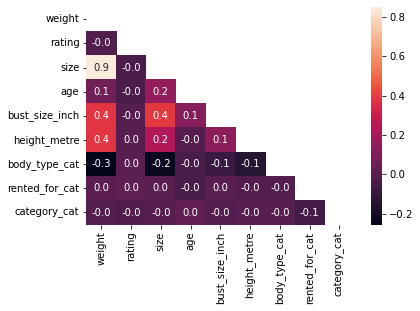

In [15]:
#First form a correlation map to observe the correlation among the features.
sns.heatmap(df[["weight", "rating", "size", "age", "bust_size_inch", "height_metre", "body_type_cat", "rented_for_cat", "category_cat"]].corr(), 
            annot=True, fmt=".1f",
            mask = np.triu(df[["weight", "rating", "size", "age", "bust_size_inch", "height_metre", "body_type_cat", "rented_for_cat", "category_cat"]].corr()))
plt.show()

## Explanatory Variables Patching
After forming the correlation map, Explanatory variables were chosen for each response variable based on their linear correlation. If the explanatory variable and response variable pair has a linear correlation of at least a magnitude of 0.2, that variable will be chosen as an explanatory variable. The patching is also done in a specific order, starting with size as the first explanatory variable to patch weight, since it has a fully filled column. After weight is patched, it is then used as an explanatory variable to predict other response variables. 

In [16]:
#May Take awhile to run the patching for NULL values
lr_mapping = {
    "weight": ["size"],
    "age": ["size"],
    "bust_size_inch": ["size", "weight"],
    "body_type_cat": ["size", "weight"],
    "height_metre": ["size", "weight"]
}

for key, val in lr_mapping.items():
    df_temp = df.dropna(subset=[key]+val)
    X = df_temp[val]
    y = df_temp[key]

    model = LinearRegression()
    model.fit(X, y)
    
    if key in ("weight", "age"):
        df.loc[df[key].isna(), key] = df.apply(lambda x: round(model.predict(np.array(x[val[0]]).reshape(1, -1))[0], 1), axis=1)
    elif key == "bust_size_inch":
        df.loc[df[key].isna(), key] = df.apply(lambda x: round(model.predict([x[val]])[0], 1), axis=1)
    elif key == "height_metre":
        df.loc[df[key].isna(), key] = df.apply(lambda x: round(model.predict([x[val]])[0], 2), axis=1)
    else: # for categorical variables
        df.loc[df[key].isna(), key] = df.apply(lambda x: int(model.predict([x[val]])[0]), axis=1)

In [17]:
#Check for NULL entries
df.isna().sum()

fit                   0
user_id               0
item_id               0
weight                0
rating               81
rented_for           10
review_text           0
body_type         14625
review_summary        0
category              0
size                  0
age                   0
review_date           0
bust_size_inch        0
height_metre          0
is_not_fit            0
body_type_cat         0
rented_for_cat       10
category_cat          0
dtype: int64

## Remaining NULL Values
Since rating and rented_for have little to no linear correlation with any of the other variables and the number of NULL rows is small, we have decided to drop the rows containing NULL for rating and rented_for. The predicted data for the other columns were then inverse transformed back to their original strings.

In [18]:
df = df.dropna(subset=["rating", "rented_for", "rented_for_cat"]).reset_index(drop=True)
df["body_type"] = df["body_type_cat"].apply(lambda x: le_dict["body_type"].inverse_transform(np.array(int(x)).reshape(1, -1))[0])
df.head()

,fit,user_id,item_id,weight,rating,rented_for,review_text,body_type,review_summary,category,size,age,review_date,bust_size_inch,height_metre,is_not_fit,body_type_cat,rented_for_cat,category_cat
0,fit,420272,2260466,137.0,10.0,vacation,An adorable romper! Belt and zipper were a lit...,hourglass,So many compliments!,romper,14,28.0,"April 20, 2016",30.0,1.73,0.0,3.0,6.0,44.0
1,fit,273551,153475,132.0,10.0,other,I rented this dress for a photo shoot. The the...,straight & narrow,I felt so glamourous!!!,gown,12,36.0,"June 18, 2013",32.0,1.68,0.0,6.0,3.0,20.0
2,fit,360448,1063761,119.8,10.0,party,This hugged in all the right places! It was a ...,hourglass,It was a great time to celebrate the (almost) ...,sheath,4,116.0,"December 14, 2015",30.5,1.63,0.0,3.0,4.0,45.0
3,fit,909926,126335,135.0,8.0,formal affair,I rented this for my company's black tie award...,pear,Dress arrived on time and in perfect condition.,dress,8,34.0,"February 12, 2014",31.0,1.65,0.0,4.0,2.0,16.0
4,fit,151944,616682,145.0,10.0,wedding,I have always been petite in my upper body and...,athletic,Was in love with this dress !!!,gown,12,27.0,"September 26, 2016",32.0,1.75,0.0,1.0,7.0,20.0


In [19]:
df.isna().sum()

fit               0
user_id           0
item_id           0
weight            0
rating            0
rented_for        0
review_text       0
body_type         0
review_summary    0
category          0
size              0
age               0
review_date       0
bust_size_inch    0
height_metre      0
is_not_fit        0
body_type_cat     0
rented_for_cat    0
category_cat      0
dtype: int64

## Additional NULL Values Handling
Additionally, we will also remove rows that contain N/A or NaN as review text (They may still be recorded as String and won"t be classified as 
actual NaN values in DataFrame), since textual features will be mainly used for classification.

In [20]:
#Additionally, we will also remove rows that contain N/A or NaN as review text, since textual features will be mainly used for classification.
df = df.drop(columns=["body_type_cat", "rented_for_cat", "category_cat"])
df = df.loc[df["review_text"].str.lower()!="n/a"]
df = df.loc[df["review_text"].str.lower()!="na"]
df = df.rename({"review_text": "text"}, axis=1)
df.head()

,fit,user_id,item_id,weight,rating,rented_for,text,body_type,review_summary,category,size,age,review_date,bust_size_inch,height_metre,is_not_fit
0,fit,420272,2260466,137.0,10.0,vacation,An adorable romper! Belt and zipper were a lit...,hourglass,So many compliments!,romper,14,28.0,"April 20, 2016",30.0,1.73,0.0
1,fit,273551,153475,132.0,10.0,other,I rented this dress for a photo shoot. The the...,straight & narrow,I felt so glamourous!!!,gown,12,36.0,"June 18, 2013",32.0,1.68,0.0
2,fit,360448,1063761,119.8,10.0,party,This hugged in all the right places! It was a ...,hourglass,It was a great time to celebrate the (almost) ...,sheath,4,116.0,"December 14, 2015",30.5,1.63,0.0
3,fit,909926,126335,135.0,8.0,formal affair,I rented this for my company's black tie award...,pear,Dress arrived on time and in perfect condition.,dress,8,34.0,"February 12, 2014",31.0,1.65,0.0
4,fit,151944,616682,145.0,10.0,wedding,I have always been petite in my upper body and...,athletic,Was in love with this dress !!!,gown,12,27.0,"September 26, 2016",32.0,1.75,0.0


In [21]:
df.isna().sum()

fit               0
user_id           0
item_id           0
weight            0
rating            0
rented_for        0
text              0
body_type         0
review_summary    0
category          0
size              0
age               0
review_date       0
bust_size_inch    0
height_metre      0
is_not_fit        0
dtype: int64

In [22]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 192184 entries, 0 to 192263
Data columns (total 16 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   fit             192184 non-null  object 
 1   user_id         192184 non-null  int64  
 2   item_id         192184 non-null  int64  
 3   weight          192184 non-null  float64
 4   rating          192184 non-null  float64
 5   rented_for      192184 non-null  object 
 6   text            192184 non-null  object 
 7   body_type       192184 non-null  object 
 8   review_summary  192184 non-null  object 
 9   category        192184 non-null  object 
 10  size            192184 non-null  int64  
 11  age             192184 non-null  float64
 12  review_date     192184 non-null  object 
 13  bust_size_inch  192184 non-null  float64
 14  height_metre    192184 non-null  float64
 15  is_not_fit      192184 non-null  float64
dtypes: float64(6), int64(3), object(7)
memory usage: 24.9+ M

## Feature Engineer

To attempt and further improve the model's pattern/behavior recognition for data, featue engineering was peformed on weight and height to get the BMI feature.

In [23]:
#Calcuation of Customer"s BMI
df["BMI"] = round((df["weight"] * 0.453592)/(df["height_metre"]**2),2)

# Natural Language Processing (NLP)

## Sentiment Analysis
The sentiment of reviews are done on an overview/overall level and the entire review_text and its score is recorded in the DataFrame. In this portion, the sentiment/polarity score is calculated using TextBlob. This score will then be utilised as a feature to try and improve the interpretability for our model predictions.


In [24]:
# Overview sentiment analysis on review_text
def sentiment(x):
    if x < 0:
        return "negative"
    elif x == 0:
        return "neutral"
    else:
        return "positive"
    
def polarity(text):
    return TextBlob(text).sentiment.polarity

In [25]:
df["polarity_score"] = df["text"].apply(lambda x: polarity(x))

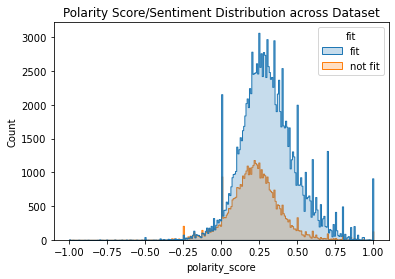

In [26]:
# Checking the general sentinment of the review_texts
sns.histplot(data = df, x = 'polarity_score', hue = 'fit', element = 'step')
plt.title("Polarity Score/Sentiment Distribution across Dataset")
plt.show()

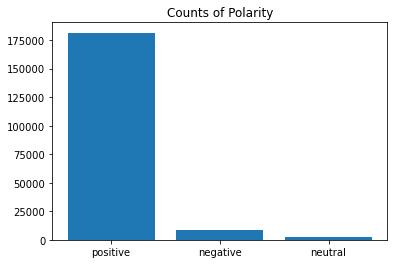

In [27]:
#Number of counts per category of Polarity of Reviews
df["polarity"] = df["polarity_score"].map(lambda x: sentiment(x))
plt.bar(df.polarity.value_counts().index, df.polarity.value_counts())
plt.title("Counts of Polarity")
plt.show()

## Text Preprocessing

A TextPreprocessing class was created to preprocess the reviews and the following cleaning methods were used: 
1. remove_emoji(): Remove emojis.
2. normalize_font(): Normalise font (𝕞𝕒𝕚𝕒 -> maia)
3. contractions(): Expand contractions (I"m -> I am)
4. generic_cleaning(): Generic cleaning: Fix unicode errors, lowercase, remove punctuations, normalise whitespace
5. Remove UTF-8 control characters for cld2
6. Identify text language using cld2, used for stopwords generation and lemmatizer
7. lemmatize_words(): Lemmatize words to their roots
8. 2 columns generated for stopword removal: 1 with stopwords removed for keyword extraction, 1 with stopwords intact for keyphrase extraction
9. Remove rows with text that contain only numbers, strings lesser than 3 characters (no meaning), and NULL

In [28]:
class TextPreprocessor:
    def __init__(self, text_df:pd.DataFrame):
        text_df = text_df.replace(r"^None$",np.NaN,regex=True)
        text_df = text_df.replace("",np.NaN)
        text_df = text_df.dropna(subset=["text"])
        text_df = text_df.reset_index(drop=True)
        self.text_df = text_df
        self.text_df["clean_text"] = self.text_df["text"].astype(str).copy() 
        self.text_df["no_sw_text"] = self.text_df["text"].astype(str).copy() 
        self.stop_words = {}

    def generate_stopwords(self):
        # nltk stopword languages
        stopword_lang = stopwords.fileids()

        # create dictionary of stopwords
        for lang in stopwords.fileids():
            self.stop_words[lang] = stopwords.words(lang)
    
    # remove UTF-8 control characters for cld2
    def remove_bad_chars(self):
        self.text_df["text"] = self.text_df["text"].apply(lambda x: regex.compile(r"[\p{Cc}\p{Cs}]+").sub("", x))
    
    # assume unknown as english for stopwords removal
    def identify_language(self):
        self.text_df["text_language"] = self.text_df["text"].apply(lambda x: cld2.detect(x)[2][0][1].lower())
        self.text_df.loc[self.text_df["text_language"]=="un", "text_language"] = "en"
        
        self.text_df["text_language_full"] = self.text_df["text"].apply(lambda x: cld2.detect(x)[2][0][0].lower())
        self.text_df.loc[self.text_df["text_language_full"]=="unknown", "text_language_full"] = "english"

    def remove_emojis(self):
        self.text_df["clean_text"] = \
            self.text_df["clean_text"].apply(lambda x: clean(x,  # change default parameters 
            fix_unicode=False,                
            to_ascii=False,                  
            lower=False,                      
            no_emoji=True))                   # remove emojis
        self.remove_empty_rows()
           
    # changes font --> 𝕞𝕒𝕚𝕒 to maia
    def normalize_font(self):
        self.text_df["clean_text"] = self.text_df["clean_text"].apply(lambda x: unicodedata.normalize("NFKC", x))
        self.remove_empty_rows()

    def contractions_helper(self, word):
        try:
            return contractions.fix(word)
        except:
            pass
        
    def contractions(self):
        self.text_df["clean_text"] = self.text_df["clean_text"].apply(lambda x: self.contractions_helper(x))
        self.remove_empty_rows()

    def generic_cleaning(self):
        self.text_df["clean_text"] = \
            self.text_df["clean_text"].apply(lambda x: clean(x, # change default parameters 
            fix_unicode=True,                 # fix various unicode errors
            to_ascii=False,                   # transliterate to closest ASCII representation
            lower=True,                       # lowercase text
            no_punct=True))                   # remove punctuations including hash symbol
        self.remove_empty_rows()
    
    # checks for bigram and trigram stopwords in text, then cleans single stop words
    def stopwords_helper(self, text:str, lang:str):
        row_stop_words = self.stop_words["english"]
        if lang in self.stop_words.keys():
            row_stop_words = self.stop_words[lang]
        split_text = text.split()
        result = text[:]
        for i in range(len(split_text)-1):
            bigram, trigram = "", ""
            bigram = " ".join([split_text[i], split_text[i+1]])
            if i < len(split_text) - 2:
                trigram = " ".join([split_text[i], split_text[i+1], split_text[i+2]])
            if row_stop_words and trigram in row_stop_words:
                result = re.sub(trigram, "", result, flags=re.IGNORECASE)
                continue
            if row_stop_words and bigram in row_stop_words:
                result = re.sub(bigram, "", result, flags=re.IGNORECASE)
        result = " ".join(word for word in result.split() if row_stop_words and word not in row_stop_words)
        return result

    def remove_stopwords(self):
        self.text_df["no_sw_text"] = self.text_df.apply(lambda x: self.stopwords_helper(x["clean_text"], x["text_language_full"]), axis=1)
        self.remove_empty_rows()

    # assume lang = "en" if unidentified or unsupported   
    def lemmatizer(self, word, lang="en"):
        supported_lang = ["bg", "ca", "cs", "cy", "da", "de", "el", "en", "es", "et", "fa", "fi", "fr", "ga", "gd", "gl", \
        "gv", "hu", "hy", "id", "it", "ka", "la", "lb", "lt", "lv", "mk", "nb", "nl", "pl", "pt", "ro", "ru", "sk", "sl", \
        "sv", "tr", "uk"]
        if lang in supported_lang:
            return " ".join(text_lemmatizer(word, lang))
        return " ".join(text_lemmatizer(word, lang="en"))

    def lemmatize_words(self):
        self.text_df["clean_text"] = self.text_df.apply(lambda x: self.lemmatizer(x["clean_text"], x["text_language"]), axis=1)

    def normalize_whitespace(self):
        self.text_df["clean_text"] = \
            self.text_df["clean_text"].apply(lambda x: clean(x, # change default parameters 
            fix_unicode=False,                
            to_ascii=False,                   
            lower=False,                       
            normalize_whitespace=True))        

    def remove_only_numbers(self):
        pattern = r"^[0-9]+$"
        self.text_df["clean_text"] = self.text_df["clean_text"].str.replace(pattern, "", regex=True)
        self.text_df["no_sw_text"] = self.text_df["no_sw_text"].str.replace(pattern, "", regex=True)

    def remove_short_strings(self):
        self.text_df["clean_text"] = self.text_df["clean_text"].apply(lambda x: "" if len(str(x)) < 3 else x)
        self.text_df["no_sw_text"] = self.text_df["no_sw_text"].apply(lambda x: "" if len(str(x)) < 3 else x)

    # shrink df after every removal to speed up
    def remove_empty_rows(self):
        self.text_df = self.text_df.replace("", np.NaN)
        self.text_df = self.text_df.dropna(subset=["clean_text", "no_sw_text"])
    
    # running in different order could result in inaccurate results
    def main(self):
        self.generate_stopwords()
        self.remove_emojis()
        self.normalize_font()
        self.contractions()
        self.generic_cleaning()
        self.normalize_whitespace()
        self.remove_bad_chars()
        self.identify_language()
        self.lemmatize_words()
        self.remove_stopwords()
        self.remove_only_numbers()
        self.remove_short_strings()
        self.remove_empty_rows()
        print("Completed.")

In [29]:
#Start preprocessing
text_preprocessor = TextPreprocessor(df)
text_preprocessor.main()
df = text_preprocessor.text_df
df.head()

Completed.


,fit,user_id,item_id,weight,rating,rented_for,text,body_type,review_summary,category,...,bust_size_inch,height_metre,is_not_fit,BMI,polarity_score,polarity,clean_text,no_sw_text,text_language,text_language_full
0,fit,420272,2260466,137.0,10.0,vacation,An adorable romper! Belt and zipper were a lit...,hourglass,So many compliments!,romper,...,30.0,1.73,0.0,20.76,0.181548,positive,a adorable romper belt and zipper be a little ...,adorable romper belt zipper little hard naviga...,en,english
1,fit,273551,153475,132.0,10.0,other,I rented this dress for a photo shoot. The the...,straight & narrow,I felt so glamourous!!!,gown,...,32.0,1.68,0.0,21.21,0.360667,positive,I rent this dress for a photo shoot the theme ...,I rent dress photo shoot theme hollywood glam ...,en,english
2,fit,360448,1063761,119.8,10.0,party,This hugged in all the right places! It was a ...,hourglass,It was a great time to celebrate the (almost) ...,sheath,...,30.5,1.63,0.0,20.45,0.489762,positive,this hug in all the right place it be a perfec...,hug right place perfect dress event I receive ...,en,english
3,fit,909926,126335,135.0,8.0,formal affair,I rented this for my company's black tie award...,pear,Dress arrived on time and in perfect condition.,dress,...,31.0,1.65,0.0,22.49,0.213056,positive,I rent this for my companys black tie award ba...,I rent companys black tie award banquet I like...,en,english
4,fit,151944,616682,145.0,10.0,wedding,I have always been petite in my upper body and...,athletic,Was in love with this dress !!!,gown,...,32.0,1.75,0.0,21.48,-0.054028,negative,I have always be petite in my upper body and e...,I always petite upper body extremely athletic ...,en,english


In [30]:
df.shape

(192013, 23)

## Exporting Cleaned Data
This cell was mainly used to check the processed dataset after all the cleaning and data patching. Initially, we re-imported the dataset back to check for any other missing values or "N/A" textual data. Additionally, it can be used to export the cleaned dataset CSV file if the processing takes too long! A copy will be posted on the Git Repository for reference.

In [31]:
#Exporting the cleaned/processed dataset.
#This cell was used to check the reimport of our cleaned dataset to look out for any potential missed-out NULL values after the patching process.
#We earlier found that there are "N/A" values that were recorded as a String and hence, we have made the necessary changes to deal with it.

df.to_csv("updated_renttherunway_clean.csv", index=False)
#df = pd.read_csv("updated_renttherunway_clean.csv")
#df.head()

# Exploratory Data Analysis (EDA)
In this section, EDA will be performed to help us get an overall understanding of the features, view the summary statistics and visualize the data. This will allow to gain a better understanding of the context and also potentially spot any anomalies that differentiate the different ground truth values.

## Quantile Statistics

In [32]:
numerical_features = ["weight","height_metre","bust_size_inch","age","size","rating","BMI"]

In [33]:
# Quantile Statistics
quantile = df[numerical_features].describe().loc[["min", "25%", "50%", "75%", "max"]].transpose()
quantile.columns = ["min", "Q1", "Q2", "Q3", "max"]
quantile["range"] = quantile["max"] - quantile["min"]
quantile["IQR"] = quantile["Q3"] - quantile["Q1"]
quantile

,min,Q1,Q2,Q3,max,range,IQR
weight,50.00,125.00,135.00,150.0,300.00,250.00,25.00
height_metre,1.37,1.60,1.65,1.7,1.98,0.61,0.10
bust_size_inch,19.00,30.00,31.00,32.0,44.00,25.00,2.00
age,0.00,29.00,32.00,37.0,117.00,117.00,8.00
size,0.00,8.00,12.00,16.0,58.00,58.00,8.00
rating,2.00,8.00,10.00,10.0,10.00,8.00,2.00
BMI,8.04,20.49,22.19,24.5,54.43,46.39,4.01


## Descriptive Statistics 

In [34]:
#General Descriptive Statistics for Numerical Features
descriptive_stats = df[numerical_features].describe().loc[["mean", "std", "50%"]].transpose()
descriptive_stats.columns = ["mean", "std", "median"]
descriptive_stats["mode"] = df[numerical_features].mode().transpose()[0]
descriptive_stats["mad"] = [stats.median_abs_deviation(df[x]) for x in numerical_features]
descriptive_stats["kurtosis"] = [stats.kurtosis(df[x], fisher=False) for x in numerical_features]
descriptive_stats["excess kurtosis"] = [stats.kurtosis(df[x], fisher=True) for x in numerical_features]
descriptive_stats["skewness"] = [stats.skew(df[x]) for x in numerical_features]
descriptive_stats

,mean,std,median,mode,mad,kurtosis,excess kurtosis,skewness
weight,139.113828,22.525119,135.00,130.00,13.00,6.241306,3.241306,1.316827
height_metre,1.659258,0.067995,1.65,1.63,0.05,2.757068,-0.242932,0.077942
bust_size_inch,31.256310,1.898995,31.00,32.00,1.00,3.627368,0.627368,-0.153998
age,33.867862,8.039215,32.00,31.00,4.00,8.628243,5.628243,1.506841
size,12.246712,8.498010,12.00,8.00,4.00,6.034792,3.034792,1.324172
rating,9.092301,1.430211,10.00,10.00,0.00,7.035763,4.035763,-1.838266
BMI,22.929090,3.549300,22.19,22.19,1.81,7.397073,4.397073,1.594200


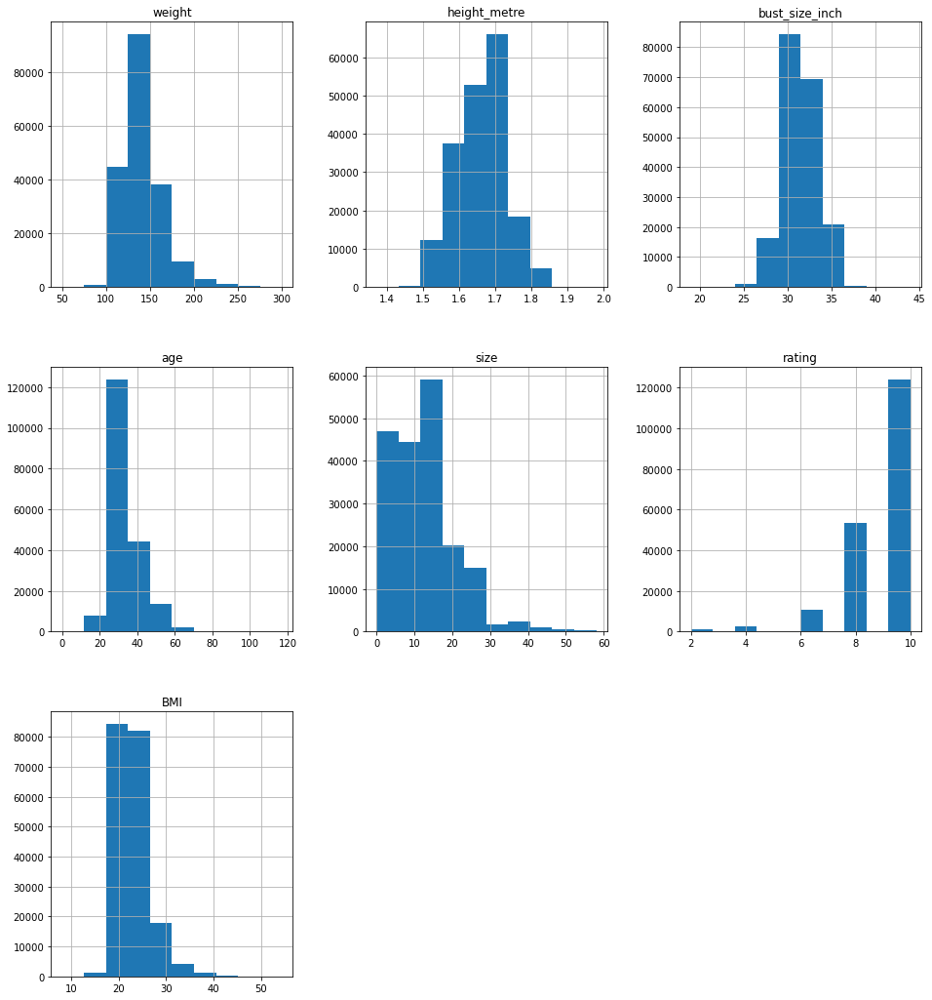

In [35]:
#Distribution for numerical features
df[numerical_features].hist(figsize = (16,18))
plt.show()

## Categorical Variables

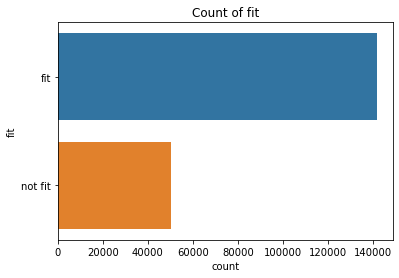

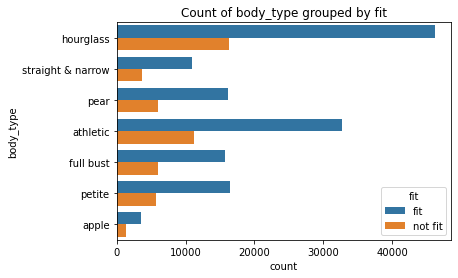

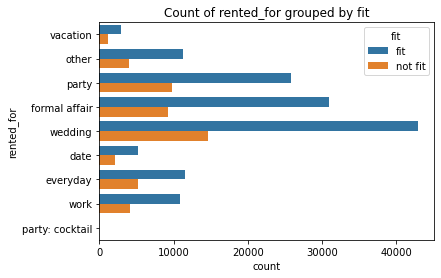

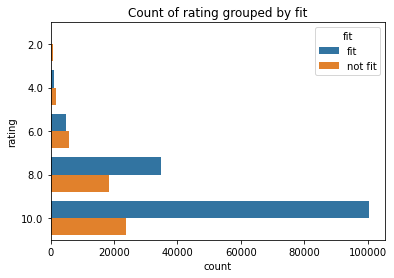

In [36]:
# Visualising categorical Features
viz_categorical_cols = ["fit", "body_type", "rented_for", "rating"]

for col in viz_categorical_cols:
    if col == "fit": 
        sns.countplot(data=df, y=col).set(title=f"Count of {col}")
    else:
        sns.countplot(data=df, y=col, hue="fit").set(title=f"Count of {col} grouped by fit")
    plt.show()

## Continuous Variables

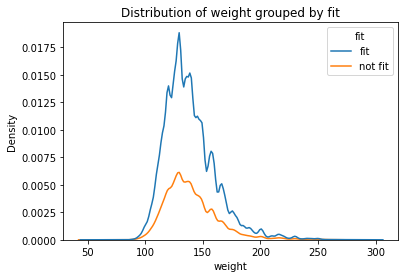

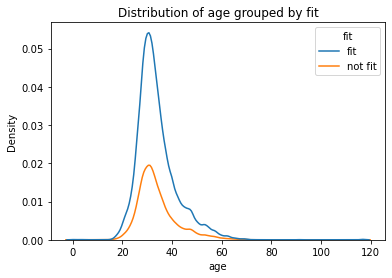

In [37]:
#Visualising the distribution density of weight and age
viz_kde_cols = ["weight", "age"]

for col in viz_kde_cols:
    sns.kdeplot(data=df, x=col, hue="fit").set(title=f"Distribution of {col} grouped by fit")
    plt.show()

## Independent Density Normalisation

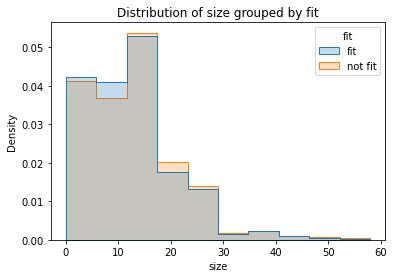

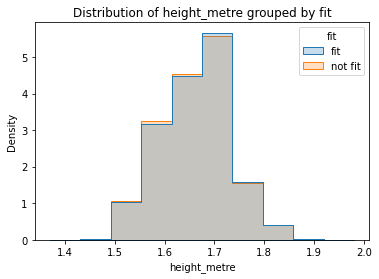

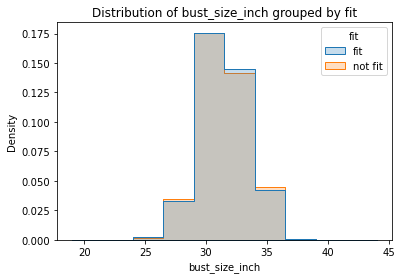

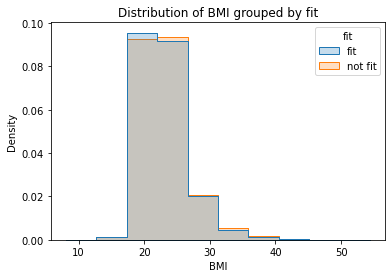

In [38]:
#Visualising the distribution density of independent continuous variables to the y variable: size, height, bust
viz_hist_cols = ["size", "height_metre", "bust_size_inch", "BMI"]

for col in viz_hist_cols:
    sns.histplot(data=df, x=col, bins=10, hue="fit", element="step",stat="density", common_norm=False).set(title=f"Distribution of {col} grouped by fit")
    plt.show()

## Joint Categorical Distribution

This section dives deeper into the dataset by exploring the distribution of the data when grouping by the different categorical features and exploring the distribution of fits.

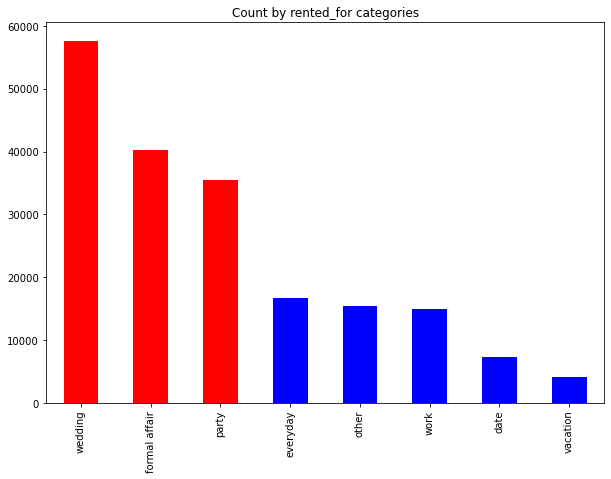

In [39]:
remove_party = df['rented_for'] == 'party: cocktail'
rented_for = df[~remove_party]
rent_counts = rented_for['rented_for'].value_counts()

top_3 = [i for i in rent_counts[:3]]
clrsf = ['red' if x in top_3 else 'blue' for x in rent_counts]
plt.figure(figsize = (10,7))
rent_counts.plot(kind = 'bar', color = clrsf)
plt.title('Count by rented_for categories')
plt.show()

In [46]:
def barchart_wed(event):
    event_df  = df[df['rented_for']==event]
    output = []
    body_df, fit_event, nonfit_event = [],[],[]
    for body in df['body_type'].unique():
        is_cat =  event_df['body_type']==body
        chosencat = event_df[is_cat] #for one particular rented for category. Then, pick out fit and sum the counts
        store_df = list(chosencat.fit.value_counts())
        perct_fit = store_df[0]/ (store_df[0]+store_df[1])
        perct_notfit = store_df[1]/ (store_df[0]+store_df[1])
        output.append([body,perct_fit,perct_notfit])
        
    for lst in output:
        body_df.append(lst[0]) 
        fit_event.append(lst[1]) 
        nonfit_event.append(lst[2])
        
    top_2 = [i for i in sorted(nonfit_event, reverse = True)[:2]]
    clrs = ['red' if x in top_2 else 'orange' for x in nonfit_event]    
    ind = np.arange(1,8)
    plt.figure(figsize=(10,5))  
    plt.bar(ind, fit_event, 0.3, label='fit')
    plt.bar(ind + 0.3, nonfit_event, 0.3, label=' not fit',color=clrs)
    plt.xlabel('Body Type')
    plt.title(f'{event}: Count of fit and not fit as % of total by body types')
    plt.xticks(ind + 0.3 / 2, body_df)
    plt.legend(loc='best')
    plt.show()


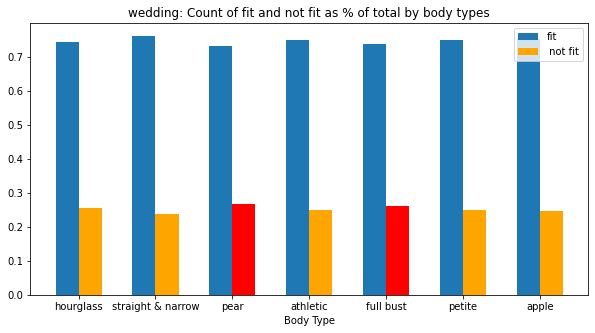

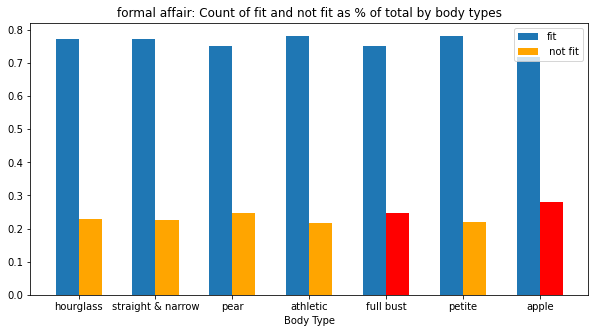

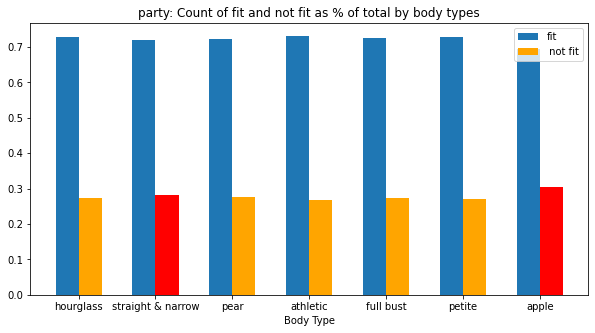

In [48]:
# % count of fit and unfit in each body type 
top_3 = ['wedding', 'formal affair', 'party']
for i in top_3:
    barchart_wed(i)

## Radar Charts for Body Type

To better understand the relation betwene the categorical and numerical feature, the dataset is grouped by the customer"s body type and the mean metric of each feature is calculated. Since these features are all measured on scales with largely different magnitudes, a MinMaxScaler is used to transform the values to range from 0 to 1. The data is then plotted on radar charts, each plotted separately to better visualise the mean features of each body type. Although it doesn't truly scale to real life sizes, it gives us a general idea of what different body types demographics numbers look like.

In [49]:
df_body_type = df.groupby("body_type")[["body_type", "bust_size_inch", "height_metre", "weight", "size", "age", "BMI"]].mean()
df_body_type = pd.DataFrame(MinMaxScaler().fit_transform(df_body_type), index=df_body_type.index, columns=df_body_type.columns)
df_body_type

,bust_size_inch,height_metre,weight,size,age,BMI
body_type,,,,,,
apple,1.000000,0.595114,1.000000,1.000000,1.000000,1.000000
athletic,0.442353,0.812305,0.460958,0.336948,0.173973,0.336678
full bust,0.356128,0.692691,0.805052,0.761657,0.418127,0.750142
hourglass,0.234963,0.681056,0.593351,0.499157,0.211707,0.533441
pear,0.651386,0.728294,0.662422,0.534395,0.173911,0.582625
petite,0.000000,0.000000,0.000000,0.000000,0.000000,0.209962
straight & narrow,0.290038,1.000000,0.203595,0.112270,0.060833,0.000000


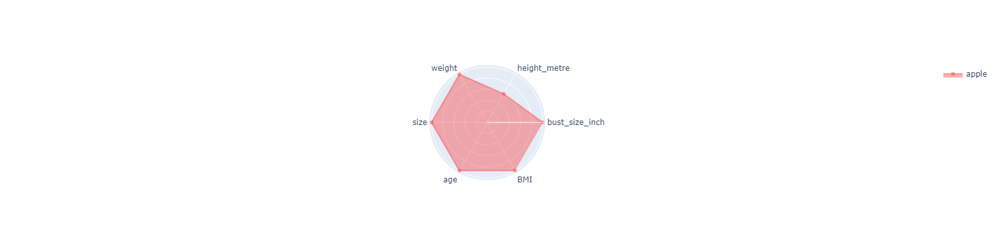

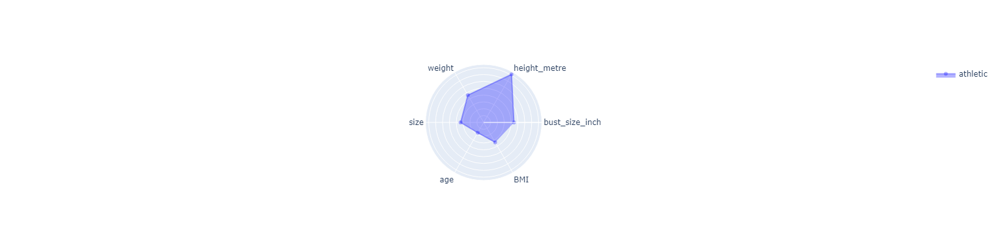

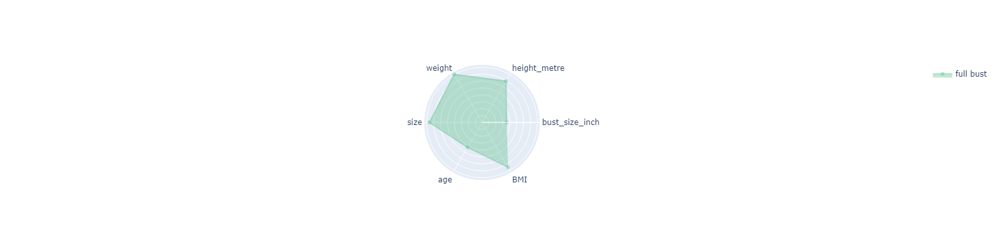

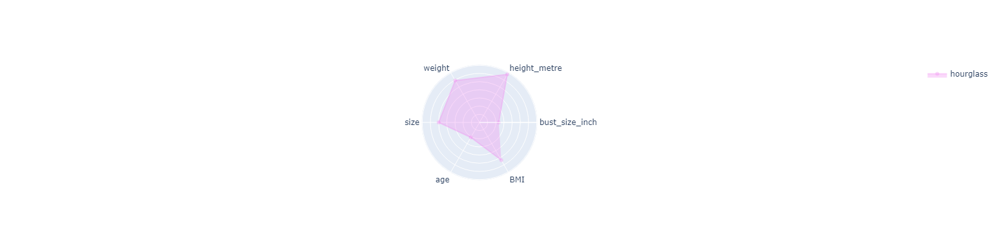

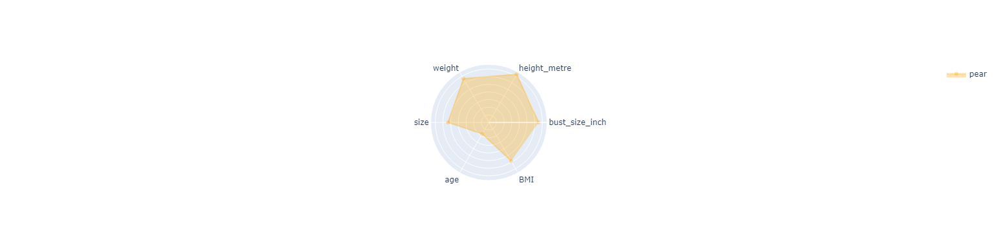

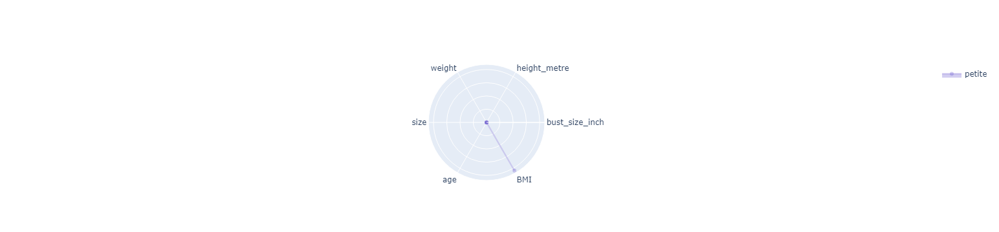

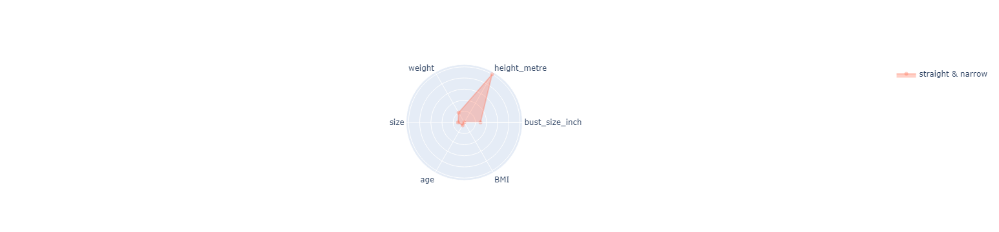

In [50]:
colours = ["rgba(255, 0, 0, 0.3)","rgba(0, 0, 255, 0.3)", "rgba(60, 179, 113, 0.3)", "rgba(238, 130, 238, 0.3)", 
           "rgba(255, 165, 0, 0.3)", "rgba(106, 90, 205, 0.3)", "rgba(255, 99, 71, 0.3)"]

#Plot radar plot to see the general attributes for each body type.
for i in range(len(df_body_type.index)):
    idx = df_body_type.index[i]
    c = colours[i]
    fig = go.Figure(data=go.Scatterpolar(r=df_body_type.loc[idx], theta=df_body_type.columns, fill="toself", line_color=c, fillcolor=c, name=idx),
                    layout=go.Layout(polar={"radialaxis": {"showticklabels": False}}, showlegend=True))
    fig.show()

## Correlation 
Correlation of the customer's demographics.

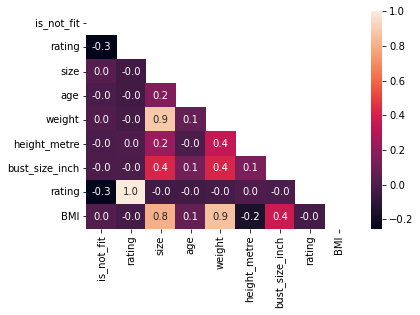

In [51]:
#Correlation of numerical features
corr = df[["is_not_fit","rating","size","age","weight","height_metre","bust_size_inch", "rating", "BMI"]].corr()
sns.heatmap(corr, annot = True, fmt=".1f", mask = np.triu(corr))
plt.show()

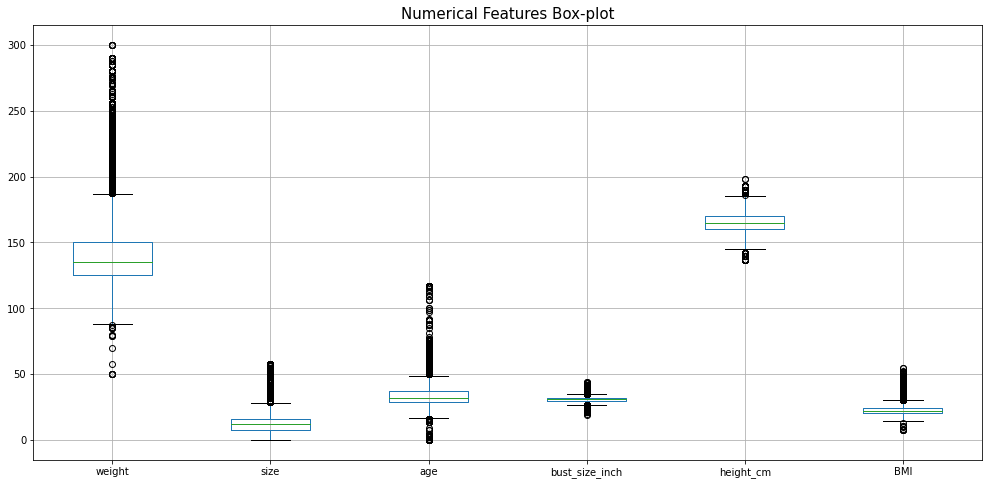

In [52]:
#Box-plot for numerical features to check distribution
df["height_cm"] = df["height_metre"] * 100
plt.figure(figsize=(17,8))
df[["weight", "size","age","bust_size_inch", "height_cm", "BMI"]].boxplot()
plt.title("Numerical Features Box-plot", fontsize=15)
plt.show()

## WordCloud
After doing the sentiment analysis, we want to see the Wordcloud Visualisation to understand the general consensus of the product reviews and observe the general words that exists in most reviews.

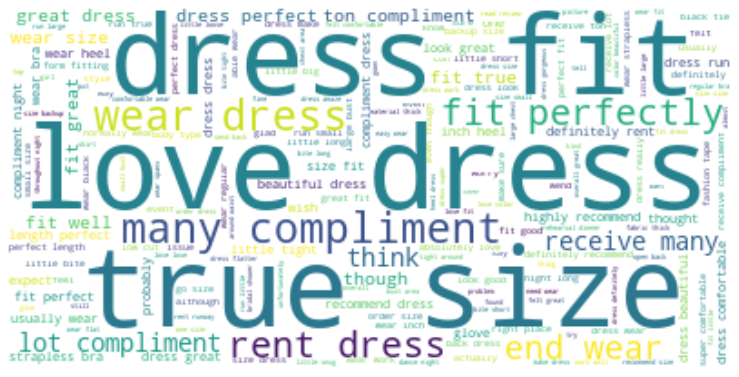

In [53]:
cloud_text = " ".join(i for i in df["no_sw_text"])
wordcloud = WordCloud(background_color = "white").generate(cloud_text)
plt.figure(figsize = (13,8))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

## Topic Modelling

Based on the general distribution of 'Fit', we previously observed that most customers favours their clothes based on their text reviews and majority fits for them. However, the same could be said for those "No Fit" customer's reviews as we generally observe positive words in the reviews as well. Additionally, the sentiment polarity distribution shows that "No Fit" customers are generally on the slightly positive side as well which could be difficult to decipher on an overview level.

Hence, to dive deeper and better understand customers whose clothes that did not fit them, we decided to look into topic modeling for these clothes reviews that did not fit them and understand the possible causes of it (Potentially identify words with lower polarity score). Note that this BERTopic initiation process may take awhile since it is using document embedding! Hence, we have saved the model and can be load with if needed!

In [54]:
#Filter for df with no fits only
bert_df = df[df['is_not_fit'] == 1]

#Preprocessing review_date to datetime
bert_df['review_date'] = pd.to_datetime(bert_df['review_date'], format = '%B %d, %Y')

#Setting up the BERTopic Model. Note: Takes very long to embed, use the pre-loaded model (Grp14_Model) for quicker access!
#umap_model = UMAP(random_state=seed)
#bert_model = BERTopic(umap_model=umap_model)
temp_no_sw_text_lst = bert_df["no_sw_text"].to_list()
#topics, probs = bert_model.fit_transform(temp_no_sw_text_lst)

In [55]:
#Saving my bert_model from the initial run/embedding, note: file size may be big >= ~400MB
#bert_model.save('Grp14_model')

In [56]:
# load the processed bert_model to avoid re-training/embedding review_text
bert_model = BERTopic.load('Grp14_model')

In [57]:
timestamp = bert_df['review_date'].to_list()
categories = bert_df['body_type'].to_list()

#setting up the topics per class for deeper visuals
topics_per_class = bert_model.topics_per_class(temp_no_sw_text_lst, classes = categories)

In [58]:
#Checking the overview of topics and counts for each reviews
bert_model.get_topic_info().head(15)

,Topic,Count,Name
0,-1,26640,-1_dress_wear_size_run
1,0,926,0_bite_rin_tiny_big
2,1,562,1_sleeve_big_short_small
3,2,460,2_jacket_coat_leather_warm
4,3,457,3_fabric_flatter_material_pattern
5,4,453,4_pregnant_month_bump_baby
6,5,426,5_lb_pound_knee_57
7,6,381,6_rib_cage_ribcage_zip
8,7,353,7_shower_bridal_baby_host
9,8,344,8_jumpsuit_jumpsuits_outfit_leg


### Topic Relationship
After extracting the topics and representations, we wanna observe the general clusters of topics.

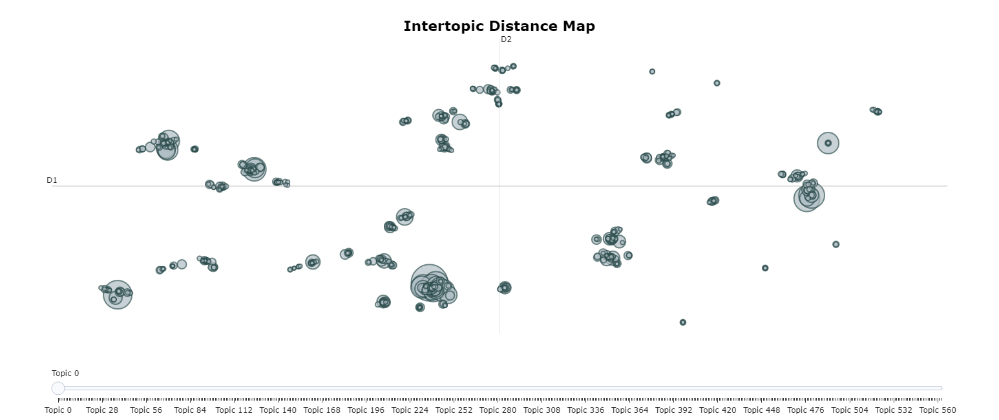

In [59]:
#Topic Relationship
bert_model.visualize_topics()

### Topics Barchart
In this section, it shows the overview of topics and the common words that are assigned to each topic. In the case of "No Fit", these topics contain words that are found within their reviews. For example, we observe that some words in topic 1 describe their experience with the rental clothes to be 'big' or 'small' maybe in the 'sleeve' area. This will give a better idea as to why customers may feel that their clothes would not fit them well. 

Afterall, clothing fit is a matter of preference and perspective where some may prefer baggy/loose for comfort or snug/tight fit for aesthetics which also differs for different clothes. Customers may like the aesthetic and provide positive comments on it, but he/she may comment about the slight discomfort and deemed it as "No Fit" which possibly explains the slight positive sentiments in "No Fit" reviews. Hence, it is also crucial to dive deeper into their reviews and understand the real intention of the reviewer!

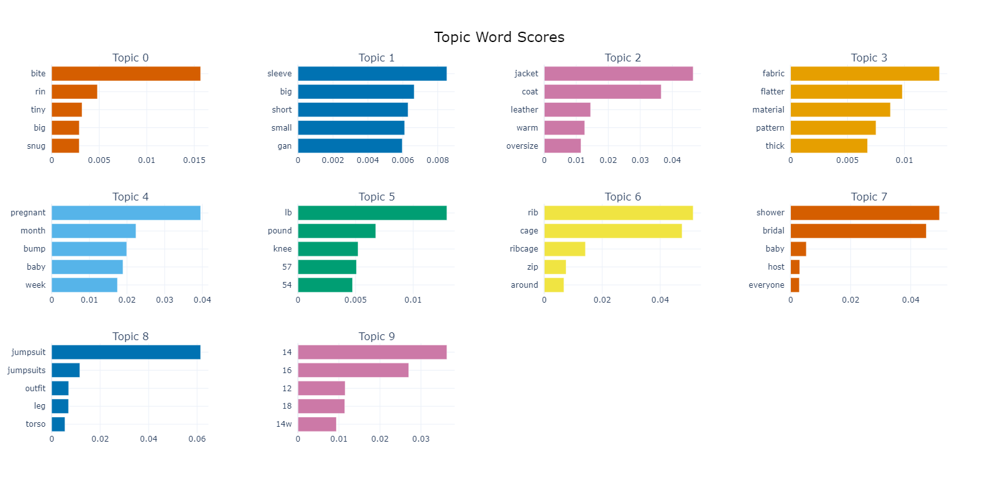

In [60]:
bert_model.visualize_barchart(top_n_topics = 10)

### Topics per Class

After getting an overview of the topics, we can also dive deeper into seeing how these clothes fit based on their reviews. Given that body metrics/demographics may not have a direct impact on the type of dress, we decided to look into the "body_type" as it is a more neutral category. (This can be changed accordingly as well!). Essentially this helps us find and understand certain subcategories that might exist in the data in relation to the reviews.


For example: topic 1_sleeve_big_short_small, we observe that reviewers with a petite body tend to comment that the fit is probably big/bulky around the sleeve area while reviewers with an athletic body tend to comment that the fit on the sleeve is short and maybe require a bigger sizing.

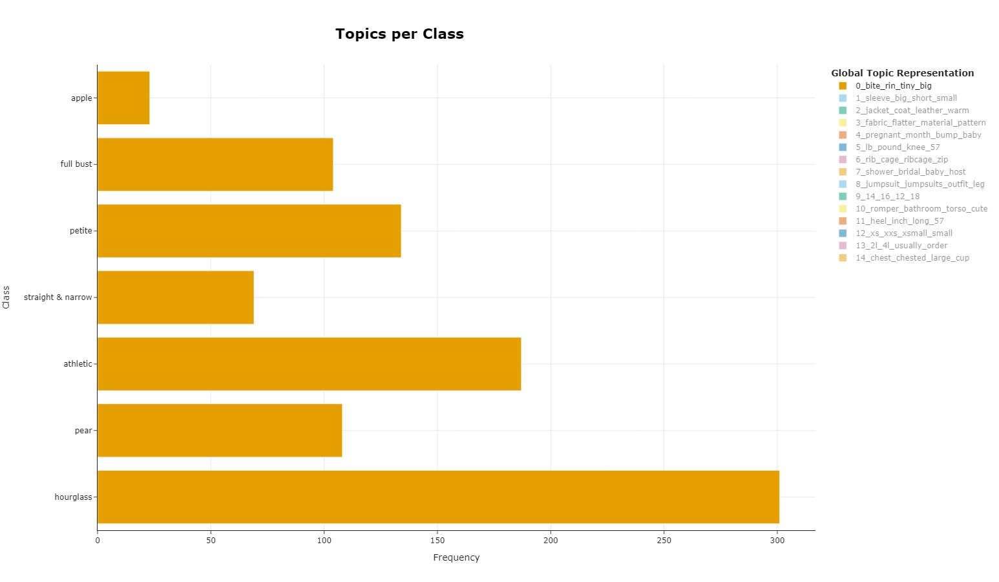

In [61]:
bert_model.visualize_topics_per_class(topics_per_class, top_n_topics=15, width=900)

### Topic Heatmap

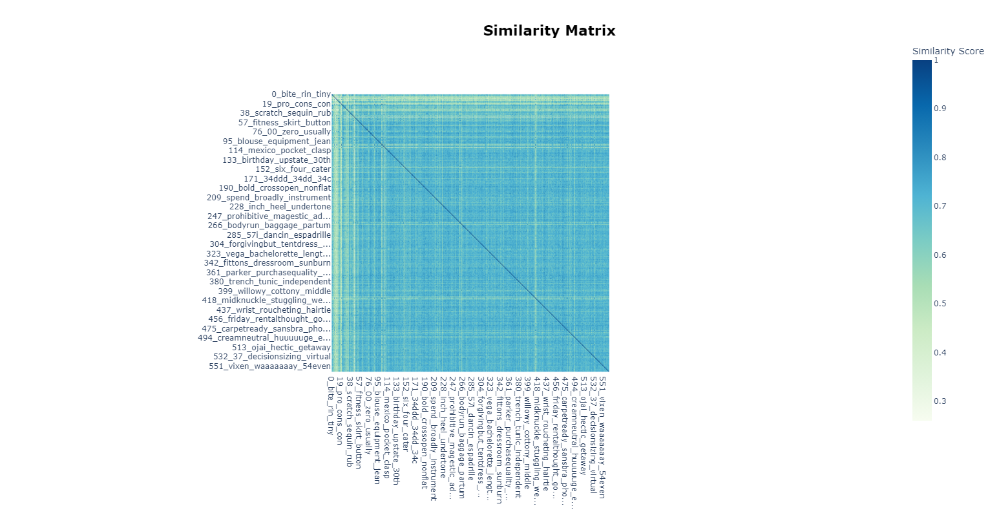

In [62]:
bert_model.visualize_heatmap()

# Preparation for Modelling
To prepare for the development of models in the following sections, the dataset will be split into 3 parts: Training, Validation and Testing data. The training data will be used to train the model while the validation data will be used to evaluate and assess the model. The final selected model will then be tested with the testing data towards the end of this notebook. On the other hand, the features will be encoded and scaled accordingly when needed depending on the model and techniques used along the way.

In [63]:
#Preparing selected features for model development and training.
#df_model = df.drop(columns=["user_id", "item_id", "text", "review_summary", "review_date", "height_cm", "clean_text", "text_language" ,"text_language_full", "no_sw_text"])
df_model = df.drop(columns=["fit", "user_id", "item_id", "text", "review_summary", "review_date", "height_cm"])
X = df_model.drop(columns=["is_not_fit"])
y = df_model["is_not_fit"]

#Splitting training, validation and testing data with 70:15:15.
X_train, X_val_test, y_train, y_val_test = train_test_split(X, y, test_size=0.3, random_state=109)
X_val, X_test, y_val, y_test = train_test_split(X_val_test, y_val_test, test_size=0.5, random_state=109)

X_train = X_train.reset_index(drop=True)
X_val = X_val.reset_index(drop=True)
X_test = X_test.reset_index(drop=True)

## One-Hot Encoding

The One-Hot Encoding technique will be used on categorical variables to convert them to a format readable by the Machine Learning Algorithms that will be used later on.

In [64]:
#Initiating new variable to be used in the base models training and comparison
#Storing all variables in the old X_train that will be used in the later portion for TF-IDF
base_X_train = X_train.copy()
base_X_val = X_val.copy()
base_X_test = X_test.copy()
base_X_train = base_X_train.drop(columns = ["clean_text", "text_language" ,"text_language_full", "no_sw_text"])
base_X_val = base_X_val.drop(columns = ["clean_text", "text_language" ,"text_language_full", "no_sw_text"])
base_X_test = base_X_test.drop(columns = ["clean_text", "text_language" ,"text_language_full", "no_sw_text"])

In [65]:
#One-hotEncoding Categorical Features
categorical_cols = ["rented_for", "body_type", "category", "polarity"]
ohe = OneHotEncoder(handle_unknown="ignore")
ohe.fit(base_X_train[categorical_cols])

df_ohe = pd.DataFrame(ohe.transform(base_X_train[categorical_cols]).toarray())
df_ohe.columns = ohe.get_feature_names_out()
base_X_train_ohe = base_X_train.join(df_ohe)
base_X_train_ohe = base_X_train_ohe.drop(columns=categorical_cols)

df_ohe = pd.DataFrame(ohe.transform(base_X_val[categorical_cols]).toarray())
df_ohe.columns = ohe.get_feature_names_out()
base_X_val_ohe = base_X_val.join(df_ohe)
base_X_val_ohe = base_X_val_ohe.drop(columns=categorical_cols)

df_ohe = pd.DataFrame(ohe.transform(base_X_test[categorical_cols]).toarray())
df_ohe.columns = ohe.get_feature_names_out()
base_X_test_ohe = base_X_test.join(df_ohe)
base_X_test_ohe = base_X_test_ohe.drop(columns=categorical_cols)

# Model Evaluation and Comparison
In this section, it is determined that we will be solving a Classification Problem and we will initiate the development of various classification models, starting with the basic model Logistic Regression followed by a tree-based model Random Forest. Additionally, we will also include more complex tree models that involves Ensemble Methods Machine Learning models which are AdaBoost, Gradient Boosting Classifier and XGBoost. All these models will be developed, trained and compared among each other accordingly. Along the way, adjustments will be made to attempt in improving the model's performance before selecting the final model and tuning it for the final test.

## Models with Base Features

In [66]:
#To record Model Performance for comparison
model_performance = {
    "Evaluation type": [],
    "Model": [],
    "Accuracy": [],
    "Precision": [],
    "Recall": [],
    "F1 score": [],
    "ROC AUC score": [],
    "Elapsed time": []
}   

In [67]:
# Function to train and evaluate multiple models
def evaluate_models(eval_type:str, X_train:pd.DataFrame, X_val:pd.DataFrame, pca:bool=False, pca_n_components:float=0.8, random_state:int=seed):
    if pca:
        models = {
            "Logistic Regression": make_pipeline(StandardScaler(), PCA(n_components=pca_n_components, random_state=seed), LogisticRegression(random_state=random_state)),
            "Random Forest": make_pipeline(PCA(n_components=pca_n_components, random_state=seed), RandomForestClassifier(random_state=random_state)),
            "AdaBoost": make_pipeline(PCA(n_components=pca_n_components, random_state=seed), AdaBoostClassifier(random_state=random_state)),
            "Gradient Boosting": make_pipeline(PCA(n_components=pca_n_components, random_state=seed), GradientBoostingClassifier(random_state=random_state)),
            "XGBoost": make_pipeline(PCA(n_components=pca_n_components, random_state=seed), XGBClassifier(verbosity=0, random_state=random_state))
        }
    else:
        models = {
            "Logistic Regression": make_pipeline(StandardScaler(), LogisticRegression(random_state=random_state)),
            "Random Forest": RandomForestClassifier(random_state=random_state),
            "AdaBoost": AdaBoostClassifier(random_state=random_state),
            "Gradient Boosting": GradientBoostingClassifier(random_state=random_state),
            "XGBoost": XGBClassifier(verbosity=0, random_state=random_state)
        }

    for name, model in models.items():
        print("#############################")
        print(name)
        print("#############################")
        
        start = time.time()
        model.fit(X_train, y_train)
        y_pred = model.predict(X_val)
        end = time.time()
        predictions = [round(value) for value in y_pred]

        print(classification_report(y_val, predictions) + "\n")

        cm = confusion_matrix(y_val, predictions)
        disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
        disp.plot()
        plt.show()
        
        model_performance["Evaluation type"].append(eval_type)
        model_performance["Model"].append(name)
        model_performance["Accuracy"].append(accuracy_score(y_val, y_pred))
        model_performance["Precision"].append(precision_score(y_val, y_pred))
        model_performance["Recall"].append(recall_score(y_val, y_pred))
        model_performance["F1 score"].append(f1_score(y_val, y_pred))
        model_performance["ROC AUC score"].append(roc_auc_score(y_val, y_pred))
        model_performance["Elapsed time"].append(end-start)     

#############################
Logistic Regression
#############################
              precision    recall  f1-score   support

         0.0       0.76      0.97      0.85     21240
         1.0       0.61      0.14      0.23      7562

    accuracy                           0.75     28802
   macro avg       0.69      0.56      0.54     28802
weighted avg       0.72      0.75      0.69     28802




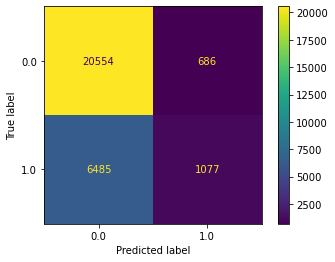

#############################
Random Forest
#############################
              precision    recall  f1-score   support

         0.0       0.76      0.94      0.84     21240
         1.0       0.53      0.17      0.26      7562

    accuracy                           0.74     28802
   macro avg       0.64      0.56      0.55     28802
weighted avg       0.70      0.74      0.69     28802




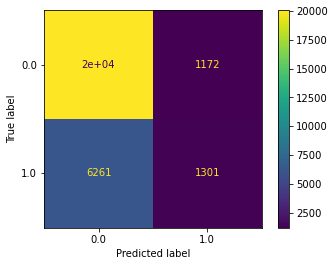

#############################
AdaBoost
#############################
              precision    recall  f1-score   support

         0.0       0.76      0.96      0.85     21240
         1.0       0.60      0.15      0.24      7562

    accuracy                           0.75     28802
   macro avg       0.68      0.56      0.55     28802
weighted avg       0.72      0.75      0.69     28802




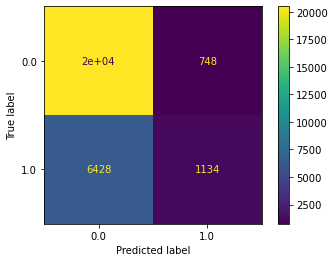

#############################
Gradient Boosting
#############################
              precision    recall  f1-score   support

         0.0       0.76      0.97      0.85     21240
         1.0       0.62      0.14      0.23      7562

    accuracy                           0.75     28802
   macro avg       0.69      0.56      0.54     28802
weighted avg       0.72      0.75      0.69     28802




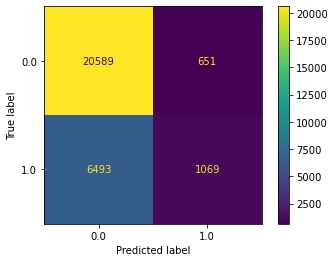

#############################
XGBoost
#############################
              precision    recall  f1-score   support

         0.0       0.76      0.95      0.85     21240
         1.0       0.57      0.18      0.27      7562

    accuracy                           0.75     28802
   macro avg       0.67      0.56      0.56     28802
weighted avg       0.71      0.75      0.70     28802




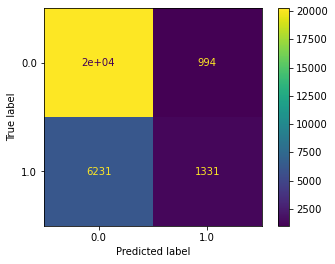

In [68]:
# Developing and Training base models.
evaluate_models("Base model", base_X_train_ohe, base_X_val_ohe)

### Model Comparison on Base Features
Comparison of all Base Models performance.

In [69]:
#Results of Models with base features
result_table = pd.DataFrame.from_dict(model_performance)
print(tabulate(result_table, headers="keys", tablefmt="fancy_outline"))

╒════╤═══════════════════╤═════════════════════╤════════════╤═════════════╤══════════╤════════════╤═════════════════╤════════════════╕
│    │ Evaluation type   │ Model               │   Accuracy │   Precision │   Recall │   F1 score │   ROC AUC score │   Elapsed time │
╞════╪═══════════════════╪═════════════════════╪════════════╪═════════════╪══════════╪════════════╪═════════════════╪════════════════╡
│  0 │ Base model        │ Logistic Regression │   0.751024 │    0.610891 │ 0.142423 │   0.230992 │        0.555063 │        1.14568 │
│  1 │ Base model        │ Random Forest       │   0.741928 │    0.526082 │ 0.172044 │   0.259292 │        0.558433 │       29.868   │
│  2 │ Base model        │ AdaBoost            │   0.750851 │    0.60255  │ 0.14996  │   0.240152 │        0.557372 │       11.293   │
│  3 │ Base model        │ Gradient Boosting   │   0.751962 │    0.621512 │ 0.141365 │   0.230338 │        0.555358 │       29.5792  │
│  4 │ Base model        │ XGBoost             │   0.74

## Models with Base Features & Term Frequency-Inverse Document Frequency (TF-IDF)

As an attempt to further improve our model metrics and results, we looked into using TF-IDF to attain relevant terms within the dataset"s corpus and use its score to train & test our model

In [70]:
#Initiating new variable to be used in the models with tf-idf feature training and comparison
tfidf_X_train = X_train.copy()
tfidf_X_val = X_val.copy()
tfidf_X_test = X_test.copy()

In [71]:
#One-hotEncoding Categorical Features
categorical_cols = ["rented_for", "body_type", "category", "polarity"]
ohe = OneHotEncoder(handle_unknown="ignore")
ohe.fit(tfidf_X_train[categorical_cols])

df_ohe = pd.DataFrame(ohe.transform(tfidf_X_train[categorical_cols]).toarray())
df_ohe.columns = ohe.get_feature_names_out()
tfidf_X_train_ohe = tfidf_X_train.join(df_ohe)
tfidf_X_train_ohe = tfidf_X_train_ohe.drop(columns=categorical_cols)

df_ohe = pd.DataFrame(ohe.transform(tfidf_X_val[categorical_cols]).toarray())
df_ohe.columns = ohe.get_feature_names_out()
tfidf_X_val_ohe = tfidf_X_val.join(df_ohe)
tfidf_X_val_ohe = tfidf_X_val_ohe.drop(columns=categorical_cols)

df_ohe = pd.DataFrame(ohe.transform(tfidf_X_test[categorical_cols]).toarray())
df_ohe.columns = ohe.get_feature_names_out()
tfidf_X_test_ohe = tfidf_X_test.join(df_ohe)
tfidf_X_test_ohe = tfidf_X_test_ohe.drop(columns=categorical_cols)

### Term Frequency-Inverse Document Frequency Process
Given the huge number of entries and review texts in this dataset, we will only pick the top 99% quantile of TF-IDF terms and use them as encoded features for our model prediction so as to not overload the machine"s memory. We would assume that the top 99% would yield the importance to the model"s prediction.

In [72]:
tfidf_word = TfidfVectorizer(analyzer="word")
no_sw_text_lst = tfidf_X_train_ohe.loc[~tfidf_X_train_ohe["no_sw_text"].isna()]["no_sw_text"].to_list()
tfidf_word_fit = tfidf_word.fit_transform(no_sw_text_lst)
mean_tfidf_word = tfidf_word_fit.mean(axis=0)
df_tfidf_word = pd.DataFrame(mean_tfidf_word.T, index=tfidf_word.get_feature_names_out(), columns=["tfidf"]).sort_values(by=["tfidf"], ascending=False)
threshold = df_tfidf_word.quantile(0.99)[0]
keywords_lst = df_tfidf_word.loc[df_tfidf_word["tfidf"]>=threshold].index
keywords_lst = [x for x in keywords_lst if not x.isdigit()]

concat_word_string = ""

for word in keywords_lst:
    concat_word_string += word
    concat_word_string += "|"
    
concat_word_string = concat_word_string[:-1]
concat_word_string

'dress|wear|fit|size|would|great|love|perfect|comfortable|little|get|compliment|rent|look|like|long|color|short|bite|small|tight|flatter|length|work|definitely|really|make|true|beautiful|night|bra|good|top|well|could|back|fabric|heel|order|large|wed|felt|material|receive|many|recommend|run|perfectly|one|lot|big|still|pretty|bust|waist|even|also|super|need|go|end|overall|event|fun|nice|much|right|want|around|black|cute|dance|chest|cut|arm|party|show|keep|usually|enough|though|hip|time|area|easy|thick|feel|gorgeous|stretch|way|sleeve|amaze|rtr|snug|ton|loose|give|day|inch|without|sexy|absolutely|pocket|shoulder|say|wend|side|think|able|lace|body|skirt|high|low|wish|style|since|picture|backup|try|zipper|tall|however|heavy|detail|first|hit|bottom|classy|shape|review|glove|thought|dinner|fine|regular|formal|use|normally|probably|highly|pair|see|place|strap|stretchy|sure|expect|front|room|issue|summer|sequin|worry|rin|fitting|tape|knee|slightly|strapless|medium|problem|person|zip|quality|ele

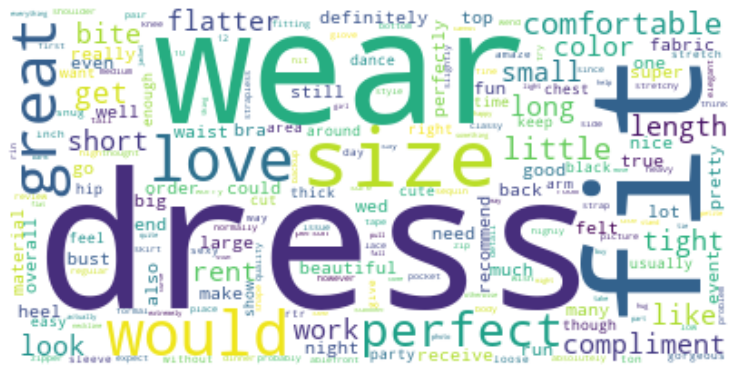

In [73]:
wordcloud = WordCloud(background_color = "white").generate_from_frequencies(df_tfidf_word.to_dict()["tfidf"])
plt.figure(figsize = (13,8))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [74]:
tfidf_phrase = TfidfVectorizer(analyzer="word", ngram_range=(2,3))
clean_text_lst = tfidf_X_train_ohe.loc[~tfidf_X_train_ohe["clean_text"].isna()]["clean_text"].to_list()
tfidf_phrase_fit = tfidf_phrase.fit_transform(clean_text_lst)
mean_tfidf_phrase = tfidf_phrase_fit.mean(axis=0)
df_tfidf_phrase = pd.DataFrame(mean_tfidf_phrase.T, index=tfidf_phrase.get_feature_names_out(), columns=["tfidf"]).sort_values(by=["tfidf"], ascending=False)
threshold = df_tfidf_phrase.quantile(0.9999)[0]
keyphrases_lst = df_tfidf_phrase.loc[df_tfidf_phrase["tfidf"]>=threshold].index

concat_phrase_string = ""

for phrase in keyphrases_lst:
    concat_phrase_string += phrase
    concat_phrase_string += "|"
    
concat_phrase_string = concat_phrase_string[:-1]
concat_phrase_string

'it be|this dress|the dress|dress be|do not|in the|and the|be very|be perfect|to size|to wear|true to|be not|and it|true to size|on the|this dress be|the dress be|of the|be little|wear it|wear this|and be|love the|the fit|but it|be great|of compliment|love this|this be|fit be|it fit|have to|many compliment|fit perfectly|the color|if you|with the|and it be|very comfortable|perfect for|lot of|love this dress|comfortable and|wear the|be so|but the|love it|rent this|for the|for my|be the|dress fit|the fabric|all night|dress for|would have|end up|dress and|so many|the top|but it be|the length|be bite|at the|color be|the back|size up|so many compliment|you be|the material|the fit be|be too|dress it|length be|to be|be beautiful|very flatter|compliment on|lot of compliment|that be|it be very|size and|but be|to the|fit true|there be|fit true to|it do|rent again|ton of|fabric be|have be|of the dress|fit great|the color be|wear this dress|material be|be perfect for|not have|the waist|it to|would 

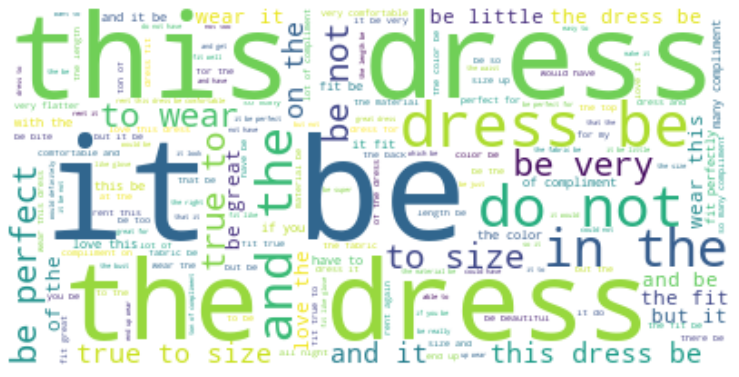

In [75]:
wordcloud = WordCloud(background_color = "white").generate_from_frequencies(df_tfidf_phrase.to_dict()["tfidf"])
plt.figure(figsize = (13,8))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.show()

In [76]:
tfidf_X_train_ohe[keywords_lst] = 0
tfidf_X_train_ohe[keyphrases_lst] = 0
tfidf_X_val_ohe[keywords_lst] = 0
tfidf_X_val_ohe[keyphrases_lst] = 0
tfidf_X_test_ohe[keywords_lst] = 0
tfidf_X_test_ohe[keyphrases_lst] = 0

#Encoding the word
for word in keywords_lst:
    tfidf_X_train_ohe.loc[tfidf_X_train_ohe["no_sw_text"].str.contains(word), word] = 1
    tfidf_X_val_ohe.loc[tfidf_X_val_ohe["no_sw_text"].str.contains(word), word] = 1
    tfidf_X_test_ohe.loc[tfidf_X_test_ohe["no_sw_text"].str.contains(word), word] = 1
    
for phrase in keyphrases_lst:
    tfidf_X_train_ohe.loc[tfidf_X_train_ohe["clean_text"].str.contains(phrase), phrase] = 1
    tfidf_X_val_ohe.loc[tfidf_X_val_ohe["clean_text"].str.contains(phrase), phrase] = 1
    tfidf_X_test_ohe.loc[tfidf_X_test_ohe["clean_text"].str.contains(phrase), phrase] = 1

In [77]:
tfidf_X_train_ohe = tfidf_X_train_ohe.drop(columns=["clean_text", "no_sw_text", "text_language", "text_language_full"])
tfidf_X_val_ohe = tfidf_X_val_ohe.drop(columns=["clean_text", "no_sw_text", "text_language", "text_language_full"])
tfidf_X_test_ohe = tfidf_X_test_ohe.drop(columns=["clean_text", "no_sw_text", "text_language", "text_language_full"])

#############################
Logistic Regression
#############################
              precision    recall  f1-score   support

         0.0       0.84      0.94      0.88     21240
         1.0       0.73      0.49      0.58      7562

    accuracy                           0.82     28802
   macro avg       0.78      0.71      0.73     28802
weighted avg       0.81      0.82      0.80     28802




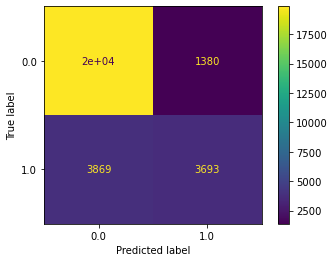

#############################
Random Forest
#############################
              precision    recall  f1-score   support

         0.0       0.82      0.96      0.88     21240
         1.0       0.78      0.41      0.54      7562

    accuracy                           0.82     28802
   macro avg       0.80      0.69      0.71     28802
weighted avg       0.81      0.82      0.79     28802




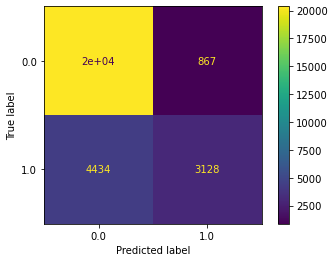

#############################
AdaBoost
#############################
              precision    recall  f1-score   support

         0.0       0.83      0.93      0.88     21240
         1.0       0.71      0.47      0.56      7562

    accuracy                           0.81     28802
   macro avg       0.77      0.70      0.72     28802
weighted avg       0.80      0.81      0.80     28802




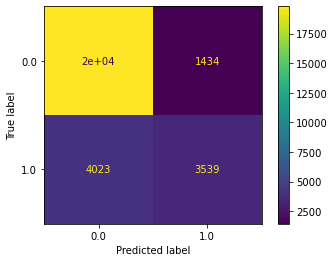

#############################
Gradient Boosting
#############################
              precision    recall  f1-score   support

         0.0       0.83      0.94      0.88     21240
         1.0       0.74      0.45      0.56      7562

    accuracy                           0.81     28802
   macro avg       0.78      0.70      0.72     28802
weighted avg       0.80      0.81      0.80     28802




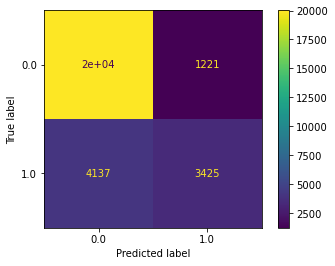

#############################
XGBoost
#############################
              precision    recall  f1-score   support

         0.0       0.84      0.93      0.88     21240
         1.0       0.72      0.51      0.60      7562

    accuracy                           0.82     28802
   macro avg       0.78      0.72      0.74     28802
weighted avg       0.81      0.82      0.81     28802




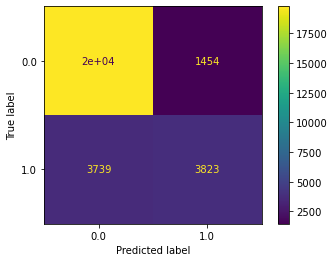

In [78]:
evaluate_models("Base model + TF-IDF", tfidf_X_train_ohe, tfidf_X_val_ohe)

### Model Comparison on Base Features with TFIDF
Comparison of Model's Performance after adding TF-IDF features into the feature list.

In [79]:
result_table = pd.DataFrame.from_dict(model_performance)
print(tabulate(result_table, headers="keys", tablefmt="fancy_outline"))

╒════╤═════════════════════╤═════════════════════╤════════════╤═════════════╤══════════╤════════════╤═════════════════╤════════════════╕
│    │ Evaluation type     │ Model               │   Accuracy │   Precision │   Recall │   F1 score │   ROC AUC score │   Elapsed time │
╞════╪═════════════════════╪═════════════════════╪════════════╪═════════════╪══════════╪════════════╪═════════════════╪════════════════╡
│  0 │ Base model          │ Logistic Regression │   0.751024 │    0.610891 │ 0.142423 │   0.230992 │        0.555063 │        1.14568 │
│  1 │ Base model          │ Random Forest       │   0.741928 │    0.526082 │ 0.172044 │   0.259292 │        0.558433 │       29.868   │
│  2 │ Base model          │ AdaBoost            │   0.750851 │    0.60255  │ 0.14996  │   0.240152 │        0.557372 │       11.293   │
│  3 │ Base model          │ Gradient Boosting   │   0.751962 │    0.621512 │ 0.141365 │   0.230338 │        0.555358 │       29.5792  │
│  4 │ Base model          │ XGBoost     

# Dimensionality Reduction

As observed, the Models with base features & TF-IDF tends to perform better overall compared to all the previous models. However, it is observed that the time taken to run those models is immensely long and hence, we have decided to use Dimensionality Reduction methods to attempt to reduce the features used for modeling and speed up the process. In this case, we have decided to use Feature Selection and PCA to reduce the dimensions and the following results can be seen below.

## Feature Selection
It is the process of isolating the most consistent, non-redundant and relevant features to use in model development in order to improve performance of a predictive model and reduce the computational cost of modeling by eliminating any obsolete or irrelevant features and narrowing down the set to those most relevant.

In [80]:
estimator = ExtraTreesClassifier(random_state=seed)
selector = SelectFromModel(estimator=estimator).fit(tfidf_X_train_ohe, y_train)

In [81]:
num_sel_cols = len(tfidf_X_train_ohe.columns[selector.get_support()].to_list())

tfidf_X_train_ohe_fs = tfidf_X_train_ohe.loc[:, selector.get_support()]
tfidf_X_val_ohe_fs = tfidf_X_val_ohe.loc[:, selector.get_support()]
tfidf_X_test_ohe_fs = tfidf_X_test_ohe.loc[:, selector.get_support()]

#############################
Logistic Regression
#############################
              precision    recall  f1-score   support

         0.0       0.83      0.93      0.88     21240
         1.0       0.72      0.47      0.57      7562

    accuracy                           0.81     28802
   macro avg       0.78      0.70      0.73     28802
weighted avg       0.80      0.81      0.80     28802




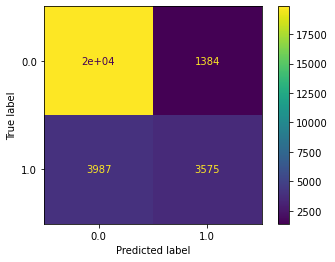

#############################
Random Forest
#############################
              precision    recall  f1-score   support

         0.0       0.83      0.95      0.88     21240
         1.0       0.75      0.44      0.56      7562

    accuracy                           0.82     28802
   macro avg       0.79      0.70      0.72     28802
weighted avg       0.81      0.82      0.80     28802




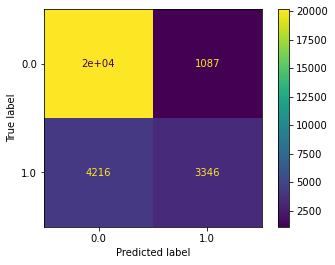

#############################
AdaBoost
#############################
              precision    recall  f1-score   support

         0.0       0.83      0.93      0.88     21240
         1.0       0.71      0.47      0.56      7562

    accuracy                           0.81     28802
   macro avg       0.77      0.70      0.72     28802
weighted avg       0.80      0.81      0.80     28802




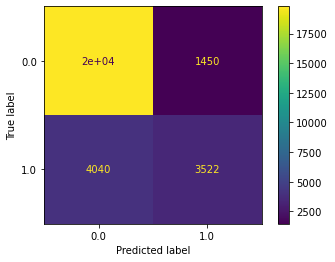

#############################
Gradient Boosting
#############################
              precision    recall  f1-score   support

         0.0       0.83      0.94      0.88     21240
         1.0       0.74      0.46      0.56      7562

    accuracy                           0.81     28802
   macro avg       0.78      0.70      0.72     28802
weighted avg       0.80      0.81      0.80     28802




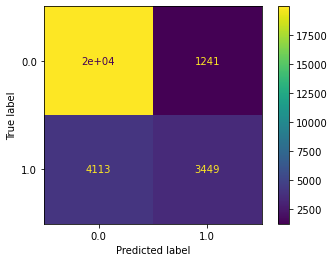

#############################
XGBoost
#############################
              precision    recall  f1-score   support

         0.0       0.84      0.93      0.88     21240
         1.0       0.73      0.50      0.59      7562

    accuracy                           0.82     28802
   macro avg       0.78      0.72      0.74     28802
weighted avg       0.81      0.82      0.81     28802




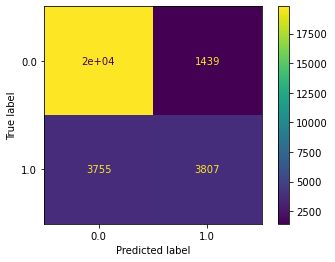

In [82]:
evaluate_models("Base model + TF-IDF + Feature selection", tfidf_X_train_ohe_fs, tfidf_X_val_ohe_fs)

## Principal Component Analysis (PCA)
It is a process to reduce the dimensionality of large datasets by creating new uncorrelated variables that successively maximise the variances. PCA increases the interpretability while preserving the maximum amount of information.

#############################
Logistic Regression
#############################
              precision    recall  f1-score   support

         0.0       0.83      0.94      0.88     21240
         1.0       0.72      0.45      0.55      7562

    accuracy                           0.81     28802
   macro avg       0.77      0.69      0.72     28802
weighted avg       0.80      0.81      0.79     28802




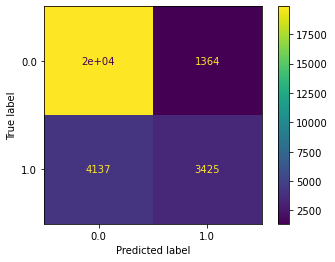

#############################
Random Forest
#############################
              precision    recall  f1-score   support

         0.0       0.79      0.96      0.86     21240
         1.0       0.70      0.28      0.40      7562

    accuracy                           0.78     28802
   macro avg       0.74      0.62      0.63     28802
weighted avg       0.76      0.78      0.74     28802




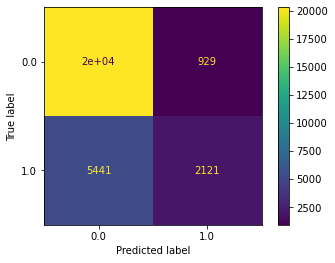

#############################
AdaBoost
#############################
              precision    recall  f1-score   support

         0.0       0.80      0.93      0.86     21240
         1.0       0.63      0.35      0.45      7562

    accuracy                           0.77     28802
   macro avg       0.71      0.64      0.65     28802
weighted avg       0.75      0.77      0.75     28802




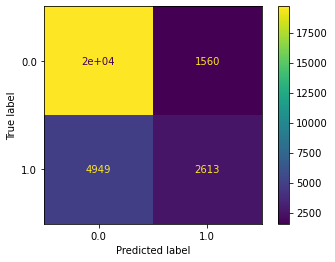

#############################
Gradient Boosting
#############################
              precision    recall  f1-score   support

         0.0       0.79      0.95      0.86     21240
         1.0       0.67      0.30      0.42      7562

    accuracy                           0.78     28802
   macro avg       0.73      0.62      0.64     28802
weighted avg       0.76      0.78      0.75     28802




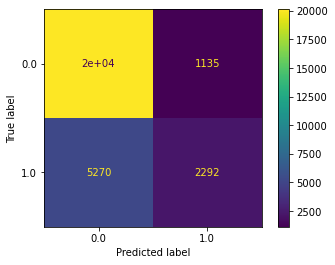

#############################
XGBoost
#############################
              precision    recall  f1-score   support

         0.0       0.81      0.92      0.86     21240
         1.0       0.64      0.40      0.49      7562

    accuracy                           0.78     28802
   macro avg       0.72      0.66      0.67     28802
weighted avg       0.76      0.78      0.76     28802




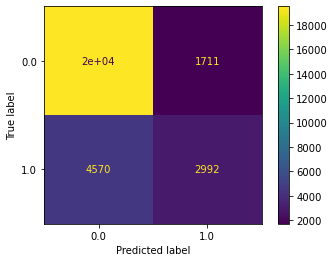

In [83]:
evaluate_models("Base model + TF-IDF + PCA", tfidf_X_train_ohe, tfidf_X_val_ohe, pca=True)

## Model Comparison on Base Features with TF-IDF with Dimensionality Reduction Methods
Comparison of all Models after Dimensionality Reduction Methods. We observed that after the Dimensionality Reduction method, the model XGBoost with TFIDF and feature selection performed the best in terms of overall performance. Although its initial XGBoost model with TF-IDF has a slightly higher performance metric overall, it takes a significantly longer time to train which is not ideal in terms of computational resources and time. Hence, we have decided to proceed with the <b>"Base model + TF-IDF + Feature selection" XGBoost Model</b> for the following processes in Hyperparameter Tuning and Model Testing.

In [84]:
result_table = pd.DataFrame.from_dict(model_performance)
print(tabulate(result_table, headers="keys", tablefmt="fancy_outline"))

╒════╤═════════════════════════════════════════╤═════════════════════╤════════════╤═════════════╤══════════╤════════════╤═════════════════╤════════════════╕
│    │ Evaluation type                         │ Model               │   Accuracy │   Precision │   Recall │   F1 score │   ROC AUC score │   Elapsed time │
╞════╪═════════════════════════════════════════╪═════════════════════╪════════════╪═════════════╪══════════╪════════════╪═════════════════╪════════════════╡
│  0 │ Base model                              │ Logistic Regression │   0.751024 │    0.610891 │ 0.142423 │   0.230992 │        0.555063 │        1.14568 │
│  1 │ Base model                              │ Random Forest       │   0.741928 │    0.526082 │ 0.172044 │   0.259292 │        0.558433 │       29.868   │
│  2 │ Base model                              │ AdaBoost            │   0.750851 │    0.60255  │ 0.14996  │   0.240152 │        0.557372 │       11.293   │
│  3 │ Base model                              │ Gradient 

# Hyperparameter Tuning

In an attempt to further improve the model's generalization, we proceeded with hyperparameter tuning. In this case, we will be using the Halving techniques of both RandomSearchCV and GridSearchCV to reduce the time used to hyperparameter tune. This methods uses an approach called <i> Successive Halving </i> which trains candidates on a small proportion of the training data and in the next iteration, candidates that performed best will 'Survive' and be chosen which they will then be given more resources to compete in the next iteration. This repeats until the best set of hyperparameters are left which will be our 'best' set of hyperparameters. More information of the techniques can be found here: https://towardsdatascience.com/11-times-faster-hyperparameter-tuning-with-halvinggridsearch-232ed0160155. <br> Even so, do <b> note </b> that this portion may take some time to tune the model due to the large amount of features and parameter ranges set in place.

In [85]:
#To record XGBoost Performance for comparison
tuning_performance = {
    "Tuning type": [],
    "Model": [],
    "Accuracy": [],
    "Precision": [],
    "Recall": [],
    "F1 score": [],
    "ROC AUC score": [],
    "Mean CV score": [],
    "Number of candidates": [],
    "Elapsed time": []
}   

tuning_params = {}

tuning_model = XGBClassifier(verbosity=0, random_state=seed)
tuning_model_name = "XGBoost"

In [86]:
# Function to train and test multiple models
def param_tuning(tuning_type:str, X_train:pd.DataFrame, X_val:pd.DataFrame, model=tuning_model, model_name=tuning_model_name, grid_search:bool=False, random_search:bool=False, param_grid:dict={}):    
    n_candidates = 1
    
    for params in param_grid.values():
        n_candidates *= len(params)
    
    if grid_search:
        model = HalvingGridSearchCV(model, param_grid, scoring="f1", n_jobs=-1, min_resources="exhaust", factor=3)
    elif random_search:
        model = HalvingRandomSearchCV(model, param_grid, scoring="f1", n_jobs=-1, n_candidates="exhaust", factor=4)

    print("#############################")
    print(tuning_type)
    print("#############################")

    start = time.time()
    model.fit(X_train, y_train)
    y_pred = model.predict(X_val)
    end = time.time()
    predictions = [round(value) for value in y_pred]

    print(classification_report(y_val, predictions) + "\n")

    cm = confusion_matrix(y_val, predictions)
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
    disp.plot()
    plt.show()
    
    tuning_performance["Tuning type"].append(tuning_type)
    tuning_performance["Model"].append(model_name)
    tuning_performance["Accuracy"].append(accuracy_score(y_val, y_pred))
    tuning_performance["Precision"].append(precision_score(y_val, y_pred))
    tuning_performance["Recall"].append(recall_score(y_val, y_pred))
    tuning_performance["F1 score"].append(f1_score(y_val, y_pred))
    tuning_performance["ROC AUC score"].append(roc_auc_score(y_val, y_pred))
    tuning_performance["Number of candidates"].append(n_candidates)
    tuning_performance["Elapsed time"].append(end-start)    
    
    if grid_search or random_search:
        tuning_performance["Mean CV score"].append(model.best_score_)
        tuning_params[tuning_type] = model.best_params_
    else:
        tuning_performance["Mean CV score"].append(None)
        tuning_params[tuning_type] = model.get_params()
        print("Base model parameters\n\n" + str(model.get_params()))

#############################
Base model
#############################
              precision    recall  f1-score   support

         0.0       0.84      0.93      0.88     21240
         1.0       0.73      0.50      0.59      7562

    accuracy                           0.82     28802
   macro avg       0.78      0.72      0.74     28802
weighted avg       0.81      0.82      0.81     28802




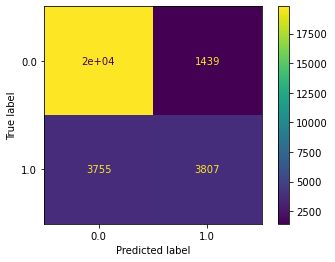

Base model parameters

{'objective': 'binary:logistic', 'use_label_encoder': None, 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': None, 'gpu_id': None, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': None, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': None, 'max_leaves': None, 'min_child_weight': None, 'missing': nan, 'monotone_constraints': None, 'n_estimators': 100, 'n_jobs': None, 'num_parallel_tree': None, 'predictor': None, 'random_state': 109, 'reg_alpha': None, 'reg_lambda': None, 'sampling_method': None, 'scale_pos_weight': None, 'subsample': None, 'tree_method': None, 'validate_parameters': None, 'verbosity': 0}


In [87]:
#Used to retrieve the current parameters for the base model
param_tuning("Base model", tfidf_X_train_ohe_fs, tfidf_X_val_ohe_fs)

#############################
Random search
#############################
              precision    recall  f1-score   support

         0.0       0.84      0.93      0.88     21240
         1.0       0.73      0.50      0.59      7562

    accuracy                           0.82     28802
   macro avg       0.79      0.72      0.74     28802
weighted avg       0.81      0.82      0.81     28802




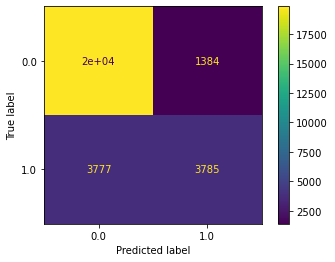

In [88]:
#Parameters ranges for Hyperparameter tuning
param_grid = {
    "objective": ["binary:logistic"],
    #"use_label_encoder": [True],
    "base_score": [0.5],
    "booster": ["gbtree"],
    "colsample_bylevel": [1],
    "colsample_bynode": [1],
    "colsample_bytree": [1],
    "gamma": [0.1, 0.2],
    "gpu_id": [-1],
    "importance_type": ["gain"],
    "interaction_constraints": [""],
    "learning_rate": [0.1, 0.2, 0.3, 0.4],
    "max_delta_step": [0],
    "max_depth": [5, 6, 7],
    "min_child_weight": [1],
    "monotone_constraints": ["()"],
    "n_estimators": [200, 250],
    "n_jobs": [8],
    "num_parallel_tree": [1],
    "random_state": [109],
    "reg_alpha": [0.2 ,0.3, 0.4],
    "reg_lambda": [0.5, 1, 2],
    "scale_pos_weight": [1], 
    "subsample": [1],
    "tree_method": ["exact"],
    "validate_parameters": [1],
    "verbosity": [0]
}

#RandomSearchCV
param_tuning("Random search", tfidf_X_train_ohe_fs, tfidf_X_val_ohe_fs, random_search=True, param_grid=param_grid)

#############################
Grid search
#############################
              precision    recall  f1-score   support

         0.0       0.84      0.94      0.88     21240
         1.0       0.73      0.50      0.59      7562

    accuracy                           0.82     28802
   macro avg       0.79      0.72      0.74     28802
weighted avg       0.81      0.82      0.81     28802




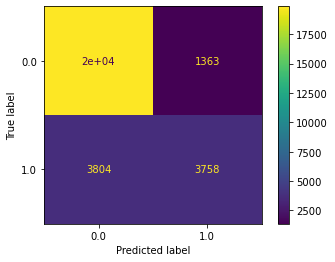

In [89]:
param_tuning("Grid search", tfidf_X_train_ohe_fs, tfidf_X_val_ohe_fs, grid_search=True, param_grid=param_grid)

In [90]:
result_table = pd.DataFrame.from_dict(tuning_performance)
print(tabulate(result_table, headers="keys", tablefmt="fancy_outline"))

╒════╤═══════════════╤═════════╤════════════╤═════════════╤══════════╤════════════╤═════════════════╤═════════════════╤════════════════════════╤════════════════╕
│    │ Tuning type   │ Model   │   Accuracy │   Precision │   Recall │   F1 score │   ROC AUC score │   Mean CV score │   Number of candidates │   Elapsed time │
╞════╪═══════════════╪═════════╪════════════╪═════════════╪══════════╪════════════╪═════════════════╪═════════════════╪════════════════════════╪════════════════╡
│  0 │ Base model    │ XGBoost │   0.819665 │    0.725696 │ 0.503438 │   0.594472 │        0.717844 │      nan        │                      1 │        9.44001 │
│  1 │ Random search │ XGBoost │   0.820811 │    0.73225  │ 0.500529 │   0.594612 │        0.717684 │        0.550125 │                    432 │      238.456   │
│  2 │ Grid search   │ XGBoost │   0.820603 │    0.733841 │ 0.496958 │   0.592604 │        0.716394 │        0.591641 │                    432 │      997.928   │
╘════╧═══════════════╧══════

In [91]:
result_table = pd.DataFrame.from_dict(tuning_params)
print(tabulate(result_table, headers="keys", tablefmt="fancy_outline"))

╒═════════════════════════╤═════════════════╤═════════════════╤═════════════════╕
│                         │ Base model      │ Random search   │ Grid search     │
╞═════════════════════════╪═════════════════╪═════════════════╪═════════════════╡
│ objective               │ binary:logistic │ binary:logistic │ binary:logistic │
│ use_label_encoder       │                 │ nan             │ nan             │
│ base_score              │                 │ 0.5             │ 0.5             │
│ booster                 │                 │ gbtree          │ gbtree          │
│ callbacks               │                 │ nan             │ nan             │
│ colsample_bylevel       │                 │ 1               │ 1               │
│ colsample_bynode        │                 │ 1               │ 1               │
│ colsample_bytree        │                 │ 1               │ 1               │
│ early_stopping_rounds   │                 │ nan             │ nan             │
│ enable_categor

# Model Testing
Finally, after all the preprocessesing, feature selection, model selection and running the hyparameter tuning techniques on the chosen model, we will be testing the finalised model with the test data that was created before.

In [92]:
final_model_performance = {
    "Accuracy": [],
    "Precision": [],
    "Recall": [],
    "F1 score": [],
    "ROC AUC score": [],
    "Elapsed time": []
}   

In [93]:
#Storing the tuned parameters (Grid Search) as backup in case the the kernel crashes or the tuning process takes too long. 
# (Use only when the tuning process fails!)
backup_tuning_params = {'base_score': 0.5, 'booster': 'gbtree','colsample_bylevel': 1, 'colsample_bynode': 1, 'colsample_bytree': 1,'gamma': 0.1, 
                        'gpu_id': -1, 'importance_type': 'gain', 'interaction_constraints': '', 'learning_rate': 0.1, 'max_delta_step': 0, 'max_depth': 6, 
                        'min_child_weight': 1, 'monotone_constraints': '()', 'n_estimators': 250, 'n_jobs': 8, 'num_parallel_tree': 1, 'objective': 'binary:logistic', 
                        'random_state': 109, 'reg_alpha': 0.4, 'reg_lambda': 2, 'scale_pos_weight': 1, 'subsample': 1, 'tree_method': 'exact', 'validate_parameters': 1, 
                        'verbosity': 0}

              precision    recall  f1-score   support

         0.0       0.84      0.94      0.89     21289
         1.0       0.74      0.50      0.60      7513

    accuracy                           0.82     28802
   macro avg       0.79      0.72      0.74     28802
weighted avg       0.81      0.82      0.81     28802




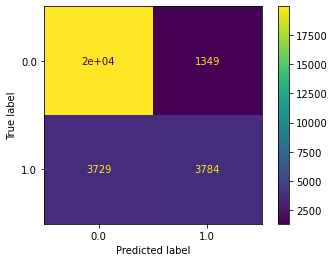

In [94]:
#Creation of Final model with the selected algorithm, features and parameters.
final_model = XGBClassifier(**tuning_params["Grid search"])

#Backup final model with the Saved(backup) parameters["Grid search"] (Comment out either lines of code accordingly!)
#final_model = XGBClassifier(**backup_tuning_params)

start = time.time()
final_model.fit(tfidf_X_train_ohe_fs, y_train)
y_pred = final_model.predict(tfidf_X_test_ohe_fs)
end = time.time()
predictions = [round(value) for value in y_pred]

print(classification_report(y_test, predictions) + "\n")

cm = confusion_matrix(y_test, predictions)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=final_model.classes_)
disp.plot()
plt.show()

final_model_performance["Accuracy"].append(accuracy_score(y_test, y_pred))
final_model_performance["Precision"].append(precision_score(y_test, y_pred))
final_model_performance["Recall"].append(recall_score(y_test, y_pred))
final_model_performance["F1 score"].append(f1_score(y_test, y_pred))
final_model_performance["ROC AUC score"].append(roc_auc_score(y_test, y_pred))
final_model_performance["Elapsed time"].append(end-start)     

In [95]:
#Output performance of finalised model with test results.
result_table = pd.DataFrame.from_dict(final_model_performance)
print(tabulate(result_table, headers="keys", tablefmt="fancy_outline"))

╒════╤════════════╤═════════════╤══════════╤════════════╤═════════════════╤════════════════╕
│    │   Accuracy │   Precision │   Recall │   F1 score │   ROC AUC score │   Elapsed time │
╞════╪════════════╪═════════════╪══════════╪════════════╪═════════════════╪════════════════╡
│  0 │   0.823693 │    0.737191 │  0.50366 │    0.59845 │        0.720147 │        24.0621 │
╘════╧════════════╧═════════════╧══════════╧════════════╧═════════════════╧════════════════╛


Based on the output of the test result, we observed that the XGBoost model is able to generalize the test dataset well and a slight improvement is seen in its overall performance. Additionally, we observe a shorter time taken as compared to the first iteration of the model with the TF-IDF features. Overall, using feature selection and tuning the model has improved the model along the way.

__Note: The final results may have slight variation if you re-run it fully again (with new tuned parameters etc...). However, it should be noted that the results would still be within the optimal range that we have initially gotten from the backup tuned parameters.__

<br>

## Model's Summary and Limitations

In summary, five different machine learning methods were analysed, namely: Logistic Regression, Random Forest, Gradient Boost, AdaBoost, and XGBoost. Using F1-score and time lapsed as performance measurements, it is determined that XGBoost (TF-IDF) with feature selection is the most appropriate model.

However, there are several limitations of the dataset and analysis. Due to the context of the dataset, there was insufficient ground truth data where the clothes don’t fit. This initially resulted in poor prediction for any label that is “not fit”. Another limitation is that the prediction using ‘fit’ and ‘not fit’ does not preserve fit ordering. Therefore, predictions are unable to inform users if a product would be too small or too big, or recommend them to size it up or down. The ultimate decision on the product size would depend on users’ judgement. 

Additionally, the context of this classification problem is more nuanced. While customers’ fit feedback reflects objective match or mismatch in product size and customer measurements, certain customers might prefer a different fit than other customers. For example, customer A prefers a baggy fit on a shirt while customer B prefers a fitted shirt. This requires further details on the fashion item’s specific style and properties, which are not provided in this dataset. Therefore, further research can be done to develop recommender systems that take into consideration customers’ feedback and preferences on different product types.
<br><br><br>

# Final Model: XGBoost Feature Importance
After running the test data through our Final XGBoost Model, we would like to further understand and interpret which variables greatly affects our model's predictions. In this case, we will be using 3 different feature importance visualisations: XGBoost's built-in feature importance, SHAP values feature importance and Permutation Importance to visualise the features importance.

## XGBoost Built-in Feature Importance

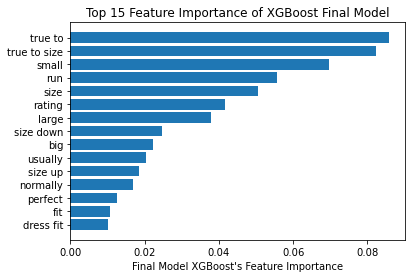

In [96]:
#Set index here to retrieve top n features. Note: there is a total of 178 features!!
idx = 15
sort_idx = final_model.feature_importances_.argsort()[-idx:]
plt.barh(tfidf_X_test_ohe_fs.columns[sort_idx], final_model.feature_importances_[sort_idx])
plt.title(f'Top {idx} Feature Importance of XGBoost Final Model')
plt.xlabel(f"Final Model XGBoost's Feature Importance")
plt.show()

## SHAP Values Feature Importance

In [97]:
explainer = shap.TreeExplainer(final_model)
shap_values = explainer.shap_values(tfidf_X_test_ohe_fs)

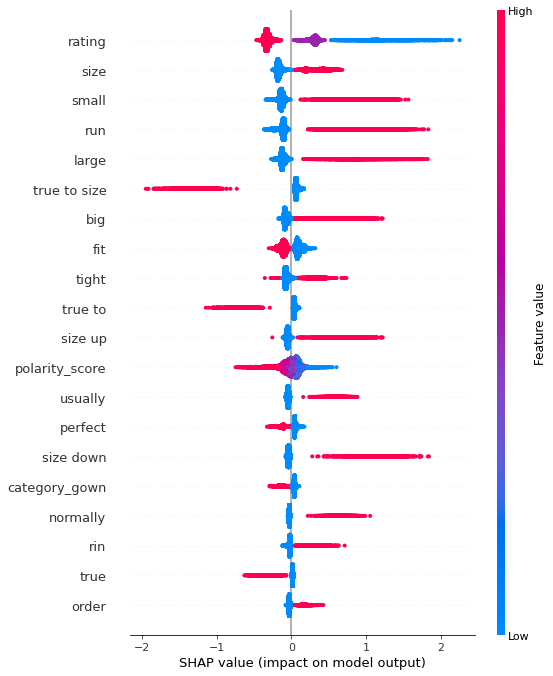

In [98]:
shap.summary_plot(shap_values, tfidf_X_test_ohe_fs)

## Permutation Based Feature Importance

In [99]:
#Permutation of Importance, Note: Takes awhile to run! ~15 mins
perm_importance = permutation_importance(final_model, tfidf_X_test_ohe_fs, y_test, n_repeats = 10, random_state = 109)

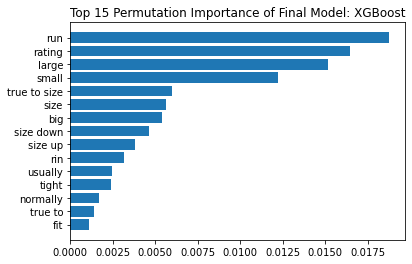

In [100]:
idx = 15
sorted_idx = perm_importance.importances_mean.argsort()[-idx:]
plt.barh(tfidf_X_test_ohe_fs.columns[sorted_idx], perm_importance.importances_mean[sorted_idx])
plt.title(f"Top {idx} Permutation Importance of Final Model: XGBoost")
plt.show()

Based on the Feature Importance from our Final Model, we observed that the word features identified using TF-IDF plays a huge importance in the predictions of the final model, and the same could be said for other models (Based on the overall results along the way as we trained and developed the models).

# Root Cause Analysis (RCA) Tool

For rental companies to understand their clothing one level deeper, an RCA (Root Cause Analysis) Tool was developed. We first grouped the data by item_id to zoom in on specific problematic items, and category as an identifier of the type of item. Depending on the focus of the company - on the proportion of "not fit" (for count > 100) or number of "not fit" - the review texts were put through a topic model, and were clustered to obtain the key topics, in an attempt to identify the root cause for causing the clothing item to not fit.

In [101]:
df_item_cnt = pd.DataFrame(df.groupby(["item_id", "category"]).size(), columns=["count"]).sort_values("item_id")
df_not_fit_cnt = pd.DataFrame(df.groupby(["item_id", "category"]).sum(), columns=["is_not_fit"]).sort_values("item_id")
df_item_not_fit = pd.concat([df_item_cnt, df_not_fit_cnt], axis=1)
df_item_not_fit["prop_not_fit"] = df_item_not_fit["is_not_fit"] / df_item_not_fit["count"]
df_item_not_fit = df_item_not_fit.sort_values("prop_not_fit", ascending=False)
df_item_not_fit.loc[df_item_not_fit["count"]>100].head()

,,count,is_not_fit,prop_not_fit
item_id,category,,,
883661,dress,188,174.0,0.925532
181453,dress,173,130.0,0.751445
154652,dress,261,196.0,0.750958
1057664,dress,256,178.0,0.695312
143094,dress,397,258.0,0.649874


In [102]:
pd.DataFrame(df.groupby(["item_id", "category"]).sum(), columns=["is_not_fit"]).sort_values("is_not_fit", ascending=False)

,,is_not_fit
item_id,category,
132738,gown,639.0
126335,dress,560.0
174086,dress,361.0
172027,dress,319.0
145906,gown,318.0
...,...,...
463334,dress,0.0
259934,sheath,0.0
1796247,dress,0.0


In [103]:
cluster_category = [(883661, "dress"), (126335, "dress")]
df_clusters_cat = pd.DataFrame()
df_cluster_cnt_cat = pd.DataFrame()
topic_models = {}

for item_id, cat in cluster_category:
    umap_model = UMAP(random_state=seed)
    topic_model = BERTopic(umap_model=umap_model)
    temp_no_sw_text_lst = df.loc[(df["item_id"]==item_id) & (df["category"]==cat) & (df["is_not_fit"]==1), "no_sw_text"].to_list()
    topics, probs = topic_model.fit_transform(temp_no_sw_text_lst)
    df_temp = topic_model.get_document_info(temp_no_sw_text_lst)
    df_temp = pd.concat([df_temp.reset_index(drop=True), df.loc[(df["item_id"]==item_id) & (df["category"]==cat) & (df["is_not_fit"]==1)].reset_index(drop=True)], axis=1)
    df_temp = df_temp.loc[df_temp["Topic"]>=0]
    df_clusters_cat = pd.concat([df_clusters_cat, df_temp])
    
    df_temp_cnt = topic_model.get_topic_info()
    df_temp_cnt = df_temp_cnt.loc[df_temp_cnt["Topic"]>=0]
    df_temp_cnt["item_id"] = item_id
    df_temp_cnt["category"] = cat
    df_cluster_cnt_cat = pd.concat([df_cluster_cnt_cat, df_temp_cnt])
    
    topic_models[item_id] = topic_model
    
df_clusters_cat = df_clusters_cat.reset_index(drop=True)
df_cluster_cnt_cat = df_cluster_cnt_cat.reset_index(drop=True)
df_clusters_cat.head()

,Document,Topic,Name,Top_n_words,Probability,Representative_document,fit,user_id,item_id,weight,...,height_metre,is_not_fit,BMI,polarity_score,polarity,clean_text,no_sw_text,text_language,text_language_full,height_cm
0,dress run size two large get backup size small...,0,0_dress_size_wear_large,dress - size - wear - large - would - fit - ru...,1.000000,True,not fit,639374,883661,210.0,...,1.73,1.0,31.83,0.160714,positive,dress run a size or two large so get your back...,dress run size two large get backup size small...,en,english,173.0
1,style run bite large size usual size back good...,0,0_dress_size_wear_large,dress - size - wear - large - would - fit - ru...,0.981070,False,not fit,659410,883661,140.0,...,1.65,1.0,23.33,0.186961,positive,this style run a bite large so you should size...,style run bite large size usual size back good...,en,english,165.0
2,dress run large I usually four six I swim four...,1,1_wear_dress_run_size,wear - dress - run - size - large - fit - 10 -...,0.862805,False,not fit,524741,883661,150.0,...,1.75,1.0,22.22,0.367857,positive,dress run large I be usually a four or a six a...,dress run large I usually four six I swim four...,en,english,175.0
3,I short curvy friend 4th july wed weekend I wa...,0,0_dress_size_wear_large,dress - size - wear - large - would - fit - ru...,1.000000,False,not fit,215689,883661,190.0,...,1.55,1.0,35.87,0.225000,positive,I be short and curvy so for my friend 4th of j...,I short curvy friend 4th july wed weekend I wa...,en,english,155.0
4,emergency overnight backup dress two I rent fi...,0,0_dress_size_wear_large,dress - size - wear - large - would - fit - ru...,1.000000,False,not fit,632147,883661,150.0,...,1.65,1.0,24.99,0.216138,positive,this be my emergency overnight backup dress be...,emergency overnight backup dress two I rent fi...,en,english,165.0


For item 883661 (dress), 2 main topics were generated. We observe that both Topics 0 and 1 seem to contain reviews mentioning the large dress size. We zoomed in to Topic 1 to see the full reviews, and indeed most reviews were mentioning about how the dress runs large. 

In [104]:
df_cluster_cnt_cat.loc[(df_cluster_cnt_cat["item_id"]==883661)].head(10)

,Topic,Count,Name,item_id,category
0,0,56,0_dress_size_wear_large,883661,dress
1,1,25,1_wear_dress_run_size,883661,dress


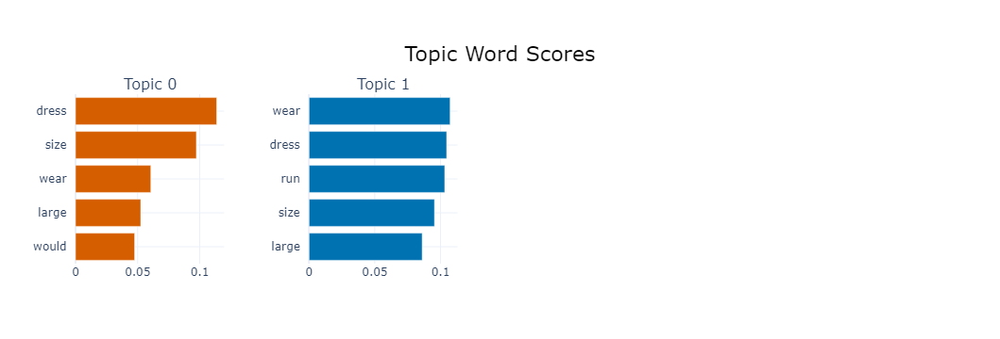

In [105]:
topic_models[883661].visualize_barchart()

In [106]:
#1_wear_run_size_dress
pd.options.display.max_colwidth = None
pd.DataFrame(df_clusters_cat.loc[(df_clusters_cat["item_id"]==883661) & (df_clusters_cat["Topic"]==1), "text"].head(10))

,text
2,"Dress runs large. I am usually a four or a six, and I was swimming in the four. The 2 fit perfectly. It really is as beautiful as the photos. I would love to rent this again, sometime. You will feel like a movie star!"
6,"This dress runs very large - I usually wear a 4 but I got a 0 and it fit, arguably was still a tad too big. I thought the color and neckline were beautiful but I have a long torso and I felt the waistline sat a little high on me. It also is a good forgiving fabric but the hips flared so much it did feel like it had too much material. But overall, a good one."
7,"This dress runs VERY LARGE. Thank god I read the reviews before ordering. I wear a size 10 and ended up ordering the size 6 and 4. I went with the size 4. It fit perfect. I am a 36DD, weigh 155lbs and my height is 5'6 and have a curvy built."
11,I recommend the dress 100% but beware it runs REALLY LARGE. I am a size 6 in a normal dress and the size 2 in this dress fit me perfectly.
12,"Like everyone else said, the dress runs really big. I usually wear a dress size 12, but on that day I wore an 8. I honestly could have wore a 6, but they didn't have any in stock to send me. Super flattering."
14,"I sized down based on feedback from other reviewers, and the dress definitely runs large. I typically wear a 4, and a 0 fit perfectly. The skirt was a little fuller than I anticipated, but the fabric was comfortable and the neckline was flattering. I am only a B-cup and needed a padded bra to fill it out, so this dress would probably be great for fuller-chested women."
18,"It was very comfortable, runs large (I usually wear a 14) and is quite low cut, so a chunky necklace makes you feel less naked. I wore a regular deep plunge bra and spanx and was fine. Highly recommend ! Definitely size down!"
26,I agree with everyone else that this dress runs very large. In most dresses I'm a 10 or 8. I wore my back up 6 and quite honestly could have worn the 4. Many compliments all evening. Low cut but tasteful. Great dress for busty women. Very comfortable also.
27,"Just like all reviewers stated, the dress runs large. I normally wear a size 12 and ordered the 8 and 6, ended up going with the 6. The material of the dress is very heavy and would add to your size. Pictured is the size 8. It's a little plain so I added the belt to complete the look. Love the dress, I got tons of compliments and it felt great."
28,"This dress definitely runs big! I ordered a 10 and an 8 as back up and ended up wearing the 8; I probably could have gone done another size, as the fabric is a bit stretchy and it's cut quite generously in the bust and straps. It's a lovely material though - it's got nice weight and texture, which really helps the skirt stand out. I also liked that there was boning at the top of the bust; it helped the dress maintain that great deep v."


For item 126335 (dress), 4 main topics were generated. We observe that both Topic 2 seems to be an interesting one about the zipper and zoomed in to see the full reviews. Most reviews were mentioning about how the zipper is difficult or impossible to zip, which is something that the company could work on. 

In [107]:
df_cluster_cnt_cat.loc[(df_cluster_cnt_cat["item_id"]==126335)].head(10)

,Topic,Count,Name,item_id,category
2,0,489,0_dress_wear_size_fit,126335,dress
3,1,16,1_zipper_dress_get_zip,126335,dress


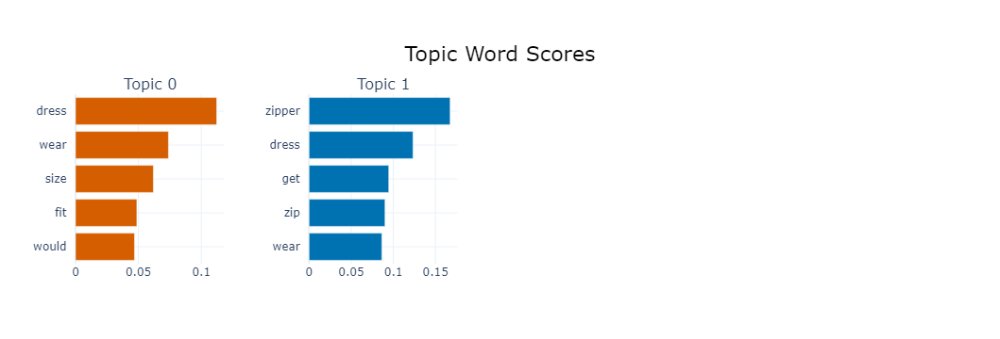

In [108]:
topic_models[126335].visualize_barchart()

In [109]:
#2_zipper_dress_get_zip
pd.options.display.max_colwidth = None
pd.DataFrame(df_clusters_cat.loc[(df_clusters_cat["item_id"]==126335) & (df_clusters_cat["Topic"]==1), "text"].head(10))

,text
81,"I normally wear a 4, but ended up wearing the 2. I am 5'8"" and 126 lbs and 34D. The 4 was too big thru the hips. The zipper was impossible to zip--but I found that if I put it on backwards and then turned it around, it worked!"
104,"I wore this for my 24th birthday celebration and felt very glamourous and beautiful. My friends were in aww and I was getting compliments all over the place. I normally wear a size 6/8, but could have went for a size 4 in this. The length was a little unflattering on me (right on the knee) so I used hem tape to make it shorter. I don't recommend this dress to girls with high hips or love handles.. I had to rock the spanx to give it a flattering silhouette. All-in-all I can't wait to rent again from RTR. Amazing experience."
109,"The zipper would slip off track around one of the seams, so getting in and out of it took some effort. I have a wide ribcage, but I still felt like it ran really small. It was a great dress though and I could wear a normal bra with it."
133,"This was my second time renting this type of dress, two years ago I rented the blue version. Because of that I was able to accurately guess my size but this dress does run big. I normally wear a 18 and the 16W I wore was still a little large on me. Dress is very low cut. Luckily someone who wore the dress before me put in an extra stitch in the top so I was not as self conciseness about everyone being able to see down my dress. The only other thing is the zipper. I was able to get it up and down no problem when the dress was not on my body. However once it was on I was not able to get the zipper up past the middle without a lot of struggling. The dress wasn't tight there so I assume it was just a sticky zipper. Had the same problem with the other dress I rented two year ago as well. Overall awesome dress that you will get lots of compliments in."
145,"Ended up wearing a size down from my usual but both sizes fit. Zippers on both sizes I ordered were very tricky - plan on having someone help you get ready! Color was more of a rose gold and very pretty, I'd rent this again."
220,"This dress was pretty, hard to zip up and much too low cut for my work event. Had to return it and unfortunately a replacement wasn't available."
225,"The color of the dress is gorgeous, but I had problems finding shoes to match. The reason I didn't end up wearing it is because the bottom of the zipper gave a weird point to my butt. My husband said it looked like I had a tail underneath the dress, so I ended up wearing my backup. Great dress, otherwise!"
283,I got tons of compliments! Perfect dress to celebrate my 28th birthday in. The zipper was REALLY hard to zip up though. My boyfriend had to use some serious elbow grease to get it to zip! Could not do it on my own. I'm usually a size 6 dress but the 4 fit better. I loved that it wasn't too short.
355,"This dress is rose-gold. The zipper was really difficult. You will need a helper, because you can't zip it on your own! Made me feel like I couldn't fit in it, but I think the zipper just has trouble where the fabric gathers.It's a very pretty but flashy (!) dress, so you will definitely get noticed. Even more bling-y in person than in the photos. That wasn't what I was going for. Too bad, because I have the cutest rose-gold heels to pair with it. I didn't end up wearing this dress. It just didn't fit/feel right for me. I'm glad I ordered a backup dress (tibi black zeppelin), which was more understated. I loved my backup, so it all worked out."
367,This dress is absolutely STUNNING. I am a 32B in the chest and it was a little bit large up top but other than that it was wonderful. I got infinite comments on how beautiful the dress was and that it was the life of the party! Wish I could keep it forever! This dress is a MUST HAVE! Didn't have any problems except the zipper in the back is a little hard to zip just due to thicker fabric but was able to get it Zipped pretty quickly! I ordered a size down ju